# Main for predicting $n_e$ and $T_e$ from langmuir probe characteristics
## Workflow
- Data is preprocessed into the format all_data and IV_df in a seperate file ... see
- This file converts the kenlinnien and auswert to the format:
all_data = 
IV_df = 

- This file:
    - Data withheld for testing
        - 3D profile
        - A random selection of 2D profiles 
    - EDA 
        - Plots full dataset
        - Removes unrealistic data
        - removes statiscially anomalous data
        - removes kenlinien that show extreamly low signal or anomalous properites
    - Data split for test validation and training
        - Cleaned data is used to test the network in order to validate performance on reliable data
        - Split of test train and validation can be changed
    - Network evaluation
        - performance of the network is evaluated on cleaned data
        - network is tested on uncleaned 2D and then 3D profiles
        - Netwrok MSE, MAE, MAPE and certainty is used to evaluate quality of uncleaned data
        

In [149]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from datetime import datetime
import math 
import os
import io
from fpdf import FPDF
import os
from tkinter.filedialog import askdirectory
import tkinter as tk
from tkinter import filedialog
import tkinter.filedialog as fd
import sys
from scipy import signal
# use mlp for prediction on multi-output regression
from numpy import asarray   
import math
# import simpledialog
from tkinter import simpledialog
# model checkpoint
from keras.callbacks import ModelCheckpoint
# import h5py
#import h5py
from scipy.signal import argrelextrema

# imort keras
import keras
import tensorflow as tf
import keras_tuner
from keras.utils import plot_model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras import layers
from tensorflow_addons.metrics import RSquare
from sklearn.neighbors import LocalOutlierFactor
#import load_model
from tensorflow.keras.models import load_model
from scipy.signal import savgol_filter
from tensorflow.keras.layers import Dropout
from sklearn.model_selection import RepeatedKFold
from sklearn import preprocessing
from tensorflow.keras.layers import BatchNormalization
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from scipy.signal import find_peaks 
from sklearn.metrics import accuracy_score
from sklearn.utils import resample
from keras.callbacks import EarlyStopping
from sklearn_pandas import DataFrameMapper
from sklearn.compose import ColumnTransformer
from sklearn.metrics import recall_score, f1_score, accuracy_score, precision_score
from sklearn.metrics import roc_curve

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
#import r2_score
from sklearn.metrics import r2_score
#import sns 
from sklearn.preprocessing import MinMaxScaler

import joblib
import seaborn as sns
import matplotlib.colors as colors

from matplotlib import gridspec

In [150]:
# get date and time
now = datetime.now()
dt_string = now.strftime("%d-%m-%Y_%H-%M")
dt_format = now.strftime("%d/%m/%Y %H:%M")
print("date and time =", dt_string)

date and time = 20-11-2023_16-29


In [151]:
#%% FUNCTIONS

def downSample(df):
    #I = df['I']
    # V = df['V']
    df = df.sort_values(by='V') #Only scales by V
    df = df.groupby(np.arange(len(df))//99).mean() #running average
    #plt.scatter(df['I'], -df['V'], marker = '.')
    return(df)

def maxNormalisation(df):
    #Normalises the data to a max of 1
    #Input: df
    #Output: df
    dfmax = df.max()
    df = df/df.max()
    return df , dfmax

def orderOfMagnitude(number):
    return math.floor(math.log(number, 10))





def popOneShot(IV_df_x, shot_pop, all_data):    
    #==============================================================================
        # pop a whole shot from the data set for testing
        # This is to show the prediction of a whole profile rather than individual points

    #==============================================================================
    # add shot to IV_df_x
    IV_df_x['shot'] = all_data['shot']
    IV_Test_X_all = pd.DataFrame()
    IV_Test_y_all = pd.DataFrame()
    all_data_test_all = pd.DataFrame()
    for shot in shot_pop:
        # find the index of the shot
        all_data_test = all_data[all_data['shot'] == shot]
        IV_Test_y = all_data[all_data['shot'] == shot]
        all_data = all_data[all_data['shot'] != shot]

        IV_Test_X = IV_df_x[IV_df_x['shot'] == shot]
        IV_df_x = IV_df_x[IV_df_x['shot'] != shot]


        
        # reset index
        IV_Test_X.reset_index(drop=True, inplace=True)
        IV_Test_y.reset_index(drop=True, inplace=True)
        all_data_test.reset_index(drop=True, inplace=True)

        IV_df_x.reset_index(drop=True, inplace=True)
        all_data.reset_index(drop=True, inplace=True)



        # Concatenate data from each shot to the all_data_test_all dataframe
        IV_Test_X_all = pd.concat([IV_Test_X_all, IV_Test_X], axis=0, ignore_index=True)
        IV_Test_y_all = pd.concat([IV_Test_y_all, IV_Test_y], axis=0, ignore_index=True)
        all_data_test_all = pd.concat([all_data_test_all, all_data_test], axis=0, ignore_index=True)
        IV_Test_y_all = IV_Test_y_all[['ne', 'Te']]
    # remove shot from IV_df_x
    IV_df_x = IV_df_x.drop(['shot'], axis=1)
    
    return IV_df_x, all_data, IV_Test_X_all, IV_Test_y_all, all_data_test_all

def removeOutliers(IV_df_x, all_data, hardlim_bool, IQR_bool):
    if hardlim_bool == True:
        startlen = len(all_data)

        te_lim = 16.76
        print('Number of outlier parameters Te>20eV: '+ str(len(all_data.loc[all_data['Te'] > te_lim])))

        ne_lim = 10**15.51527490003807
        print('Number of outlier parameters ne<10^15: '+ str(len(all_data.loc[all_data['ne'] < ne_lim])))

        ne_up_lim = 10**19.335214192867248
        print('Number of outlier parameters ne>10^19: '+ str(len(all_data.loc[all_data['ne'] > ne_up_lim])))

        R0_lim = -0.05
        R0_up_lim = 0.18
        print('Number of outlier parameters R0<-0.05: '+ str(len(all_data.loc[all_data['R_0'] < R0_lim])))
        print('Number of outlier parameters R0>0.18: '+ str(len(all_data.loc[all_data['R_0'] > R0_up_lim])))


        # get rows where te and ne are max
        lim_te_row = all_data.loc[all_data['Te'] > te_lim] 
        # delete the max te row from IV_df_x and all_data using the index
        IV_df_x = IV_df_x.drop(lim_te_row.index)
        all_data = all_data.drop(lim_te_row.index)


        # delete the max ne row from IV_df_x and all_data using the index if the index still exists
        lim_ne_row = all_data.loc[all_data['ne'] < ne_lim]
        IV_df_x = IV_df_x.drop(lim_ne_row.index)
        all_data = all_data.drop(lim_ne_row.index)

        lim_ne_row = all_data.loc[all_data['ne'] > ne_up_lim]
        IV_df_x = IV_df_x.drop(lim_ne_row.index)
        all_data = all_data.drop(lim_ne_row.index)



        # delete the max R0 row from IV_df_x and all_data using the index if the index still exists
        lim_R0_row = all_data.loc[all_data['R_0'] < R0_lim]
        IV_df_x = IV_df_x.drop(lim_R0_row.index)
        all_data = all_data.drop(lim_R0_row.index)

        lim_R0_row = all_data.loc[all_data['R_0'] > R0_up_lim]
        IV_df_x = IV_df_x.drop(lim_R0_row.index)
        all_data = all_data.drop(lim_R0_row.index)


        print('Number of IVs to be removed: '+ str(startlen - len(all_data)))
        # reset the index
        IV_df_x = IV_df_x.reset_index(drop=True)
        all_data = all_data.reset_index(drop=True)
    if IQR_bool == True: 
        # determine the outliers in the dataset using the IQR method
        # get the IQR for each column
        R0_lim = -0.01
        R0_up_lim = 0.18
        print('Number of outlier parameters R0<-0.05: '+ str(len(all_data.loc[all_data['R_0'] < R0_lim])))
        print('Number of outlier parameters R0>0.18: '+ str(len(all_data.loc[all_data['R_0'] > R0_up_lim])))
        lim_R0_row = all_data.loc[all_data['R_0'] < R0_lim]
        IV_df_x = IV_df_x.drop(lim_R0_row.index)
        all_data = all_data.drop(lim_R0_row.index)

        lim_R0_row = all_data.loc[all_data['R_0'] > R0_up_lim]
        IV_df_x = IV_df_x.drop(lim_R0_row.index)
        all_data = all_data.drop(lim_R0_row.index)

        Q1 = all_data.quantile(0.25, numeric_only=True)
        Q3 = all_data.quantile(0.75, numeric_only=True)
        IQR = Q3 - Q1
        og_len = len(all_data)
        # get the rows where the values are outside the IQR range for the values of ne and Te
        outliers = all_data.loc[all_data['ne'] < (Q1['ne'] - 1.5 * IQR['ne'])]
        all_data = all_data.drop(outliers.index)
        IV_df_x = IV_df_x.drop(outliers.index)


        outliers = all_data.loc[all_data['ne'] > (Q3['ne'] + 1.5 * IQR['ne'])]
        all_data = all_data.drop(outliers.index)
        IV_df_x = IV_df_x.drop(outliers.index)

        outliers = all_data.loc[all_data['Te'] < (Q1['Te'] - 1.5 * IQR['Te'])]
        all_data = all_data.drop(outliers.index)
        IV_df_x = IV_df_x.drop(outliers.index)

        outliers = all_data.loc[all_data['Te'] > (Q3['Te'] + 1.5 * IQR['Te'])]
        all_data = all_data.drop(outliers.index)
        IV_df_x = IV_df_x.drop(outliers.index)

        # reset the index of the dataset
        all_data = all_data.reset_index(drop=True)
        IV_df_x = IV_df_x.reset_index(drop=True)

        # print number of outliers removed
        print('Number of outliers removed: ', og_len - len(all_data))
    return IV_df_x, all_data



### 2 functions for preprocessing data
data is first preprocessed on the training data and all fittting transforms are saved to be later reused on the val and test data

In [152]:
def trainPreprocessing(X_train, y_train):
    #==============================================================================
    # Preprocessing of the training data
    #==============================================================================
    # save gas and postion and remove from X_train
    gas = X_train[['gas']]
    position = X_train[['R_0']]
    ID = X_train[['ID']]
    shot = X_train[['shot']]
    X_train = X_train.drop(['gas', 'R_0', 'ID', 'shot'], axis=1)
    # print pre pca shape
    print('X_train shape PRE PCA = ', X_train.shape)
    # normalise the IV data
    VMax = np.amax(np.abs(X_train.iloc[:,V_range].to_numpy())) #find max V
    IMax = np.amax(np.abs(X_train.iloc[:,I_range].to_numpy())) #find max I
    X_train.iloc[:,V_range] = X_train.iloc[:,V_range]/VMax
    X_train.iloc[:,I_range] = X_train.iloc[:,I_range]/IMax

    y_train[['ne']] = np.log10(y_train[['ne']])
    # normalise the y data
    neMax = np.amax(y_train[['ne']].to_numpy()) #find max ne
    TeMax = np.amax(y_train[['Te']].to_numpy()) #find max Te

    # perfrom min max scaling on ne using sklearn
    scaler = MinMaxScaler()
    scaler.fit(y_train[['ne']])
    joblib.dump(scaler, 'ne_scaler.pkl') # save scaler
    y_train[['ne']] = scaler.transform(y_train[['ne']])
    


    #y_train[['ne']] = y_train[['ne']]/neMax
    y_train[['Te']] = y_train[['Te']]/TeMax
    
    #pritn max values
    print('VMax = ', VMax)
    print('IMax = ', IMax)
    print('neMax = ', neMax)
    print('TeMax = ', TeMax)
    
    # perform PCA on the IV data
    pca = PCA(0.999)
    pca.fit(X_train)
    X_train_pca = pca.transform(X_train)
    # convert to dataframe
    X_train_pca = pd.DataFrame(X_train_pca) 
    print('X_train_pca shape = ', X_train_pca.shape)
    print('y data shape = ', y_train.shape)
    
    # normalise the gas data
    gasMax = np.amax(gas[['gas']].to_numpy()) #find max gas
    gas[['gas']] = gas[['gas']]/gasMax
    print('gasMax = ', gasMax)

    # add gas to first column of X_train_pca dataframe without nan  
    # reset index of gas and X_train_pca
    gas.reset_index(drop=True, inplace=True)
    X_train_pca.reset_index(drop=True, inplace=True)
    position.reset_index(drop=True, inplace=True)
    ID.reset_index(drop=True, inplace=True)

    X_train = pd.concat([ID, gas, position, X_train_pca], axis = 1)

    X_train = X_train.drop(['R_0'], axis=1)
    X_train = X_train.drop(['gas'], axis=1)
    X_train = X_train.drop(['ID'], axis=1)
    
    y_train = y_train[['ne', 'Te']]
    print('X_train final shape = ', X_train.shape)
    
    return X_train, y_train, VMax, IMax, neMax, TeMax, gasMax, pca

def testPreprocessing(X_test, y_test, VMax, IMax, neMax, TeMax, gasMax, pca):
    #==============================================================================
    # Preprocessing of the test data
    #==============================================================================
    # save gas and postion and remove from X_test
    gas = X_test[['gas']]
    position = X_test[['R_0']]
    ID = X_test[['ID']]
    shot = X_test[['shot']]
    X_test = X_test.drop(['gas', 'R_0', 'ID', 'shot'], axis=1)
    print('X_test shape PRE PCA = ', X_test.shape)
    # normalise the IV data
    X_test.iloc[:,V_range] = X_test.iloc[:,V_range]/VMax
    X_test.iloc[:,I_range] = X_test.iloc[:,I_range]/IMax
    print(X_test)

    
    # normalise the y data
    # take the log10 of ne
    y_test[['ne']] = np.log10(y_test[['ne']])
    loaded_scaler = joblib.load('ne_scaler.pkl')
    y_test[['ne']] = loaded_scaler.transform(y_test[['ne']])
    print('y_test ne max = ', np.amax(y_test[['ne']].to_numpy()))
    
    #y_test[['ne']] = y_test[['ne']]/neMax
    #get data type of y_test[['Te']]
    y_test[['Te']] = y_test[['Te']]/TeMax

    # perform PCA on the IV data
    X_test_pca = pca.transform(X_test)
    # convert to dataframe
    X_test_pca = pd.DataFrame(X_test_pca)
    # concat the PCA data with the gas & position data
    #print shape of X_test
    print('X_test_pca shape = ', X_test_pca.shape)
    print('y data shape = ', y_test.shape)
    # normalise the gas data
    gas[['gas']] = gas[['gas']]/gasMax

    # add gas to first column of X_test_pca dataframe 
    # reset index of gas and X_test_pca
    gas.reset_index(drop=True, inplace=True)
    X_test_pca.reset_index(drop=True, inplace=True)
    position.reset_index(drop=True, inplace=True)
    ID.reset_index(drop=True, inplace=True)

    X_test = pd.concat([ID, gas,position,  X_test_pca], axis = 1) #
    X_test = X_test.drop(['R_0'], axis=1)
    X_test = X_test.drop(['gas'], axis=1)
    X_test = X_test.drop(['ID'], axis=1)
    #X_test = X_test.drop(['shot'], axis=1)

    y_test = y_test[['ne', 'Te']]
    print('X_test final shape = ', X_test.shape)    
    
    return X_test, y_test

### Performance stats
Funcion taking the output of the netowkr and the preprocessed data to create performance stats

In [153]:
def predictionStats(pred_data, og_data, TeMax):
    # Calculate the MSE of the predictions_train
    IV_Test_y = og_data 
    pred_full = pred_data
    mse = mean_squared_error(IV_Test_y, pred_full)

    mae = mean_absolute_error(IV_Test_y, pred_full)

    MAPE = mean_absolute_percentage_error(IV_Test_y, pred_full)

    # calculate accuracy of TRAIN predictions
    r2 = r2_score(IV_Test_y, pred_full) 


    #print r2 score
    print("R2 score:", r2)
    # Print the MSE
    print("MSE: %.5f" % mse)
    print("MAE: %.5f" % mae)
    print("MAPE: %.5f" % MAPE)
    # plot predictions against true values
    pred_full = pd.DataFrame(pred_full, columns=['ne_pre','Te_pre'])

    # plot predictions against true values
    plt.figure(figsize=(2, 2))
    plt.scatter(pred_full['ne_pre'], IV_Test_y['ne'], label='ne')
    plt.scatter(pred_full['Te_pre'], IV_Test_y['Te'], label='te')
    # xlabel
    plt.xlabel('Predicted')
    # plot legenf outside of the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    # ylabel
    plt.ylabel('True')
    # plot straight line of y=x
    plt.plot([0, 1], [0, 1], transform=plt.gca().transAxes, ls="--", c=".3")
    # get percentage error on Te and ne predictions
    ne_per_err = np.abs((IV_Test_y['ne'] - pred_full['ne_pre'])/IV_Test_y['ne'])*100
    Te_per_err = np.abs((IV_Test_y['Te'] - pred_full['Te_pre'])/IV_Test_y['Te'])*100
    #print the mean percentage error
    print('Mean percentage error on Te predictions: %.2f' % np.mean(Te_per_err))
    print('Mean percentage error on ne predictions: %.2f' % np.mean(ne_per_err))

    #append ne_per_err and Te_per_err to pred_full.copy
    pred_full['ne_per_err'] = ne_per_err
    pred_full['Te_per_err'] = Te_per_err

    # how much of the dat is within 10% of the true value
    # get len of ne_per_err for <10%
    ne_10 = len(pred_full.loc[pred_full['ne_per_err'] <= 10])
    print(ne_10)
    print('Percentage of ne predictions within 10% of true value:' + str((ne_10/len(pred_full['ne_per_err'])*100)))
    Te_10 = len(pred_full.loc[pred_full['Te_per_err'] <= 10])
    print('Percentage of Te predictions within 10% of true value:' +str((Te_10/len(pred_full['ne_per_err'])*100)))

    # plt a historgram of the erorrs on Te and ne predictions in a subplot
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].hist(Te_per_err, bins=100, density = True)
    ax[0].set_xlabel('Percentage error')
    ax[0].set_ylabel('Counts')
    ax[0].set_title('Te')
    ax[0].set_xlim(0, 100)
    ax[1].hist(ne_per_err, bins=100, density = True)
    ax[1].set_xlabel('Percentage error')
    #set limits on x axis
    ax[1].set_xlim(0, 100)
    ax[1].set_ylabel('Counts')
    ax[1].set_title('ne')
    plt.tight_layout()
    plt.show()
    # scale predictions to original values using max values
    loaded_scaler = joblib.load('ne_scaler.pkl')
    pred_full[['ne_pre']] = loaded_scaler.inverse_transform(pred_full[['ne_pre']])

    pred_full['ne_pre'] = 10**pred_full['ne_pre']


    pred_full['Te_pre'] = pred_full['Te_pre'] * TeMax


    IV_Test_y[['ne']] = loaded_scaler.inverse_transform(IV_Test_y[['ne']])
    IV_Test_y['ne'] = 10**IV_Test_y['ne']
    IV_Test_y['Te'] = IV_Test_y['Te'] * TeMax
    # change index of pred_full to match IV_Test_y
    pred_full.index = IV_Test_y.index
    #make both pd dataframes
    pred_full = pd.DataFrame(pred_full)
    IV_Test_y = pd.DataFrame(IV_Test_y)
    return pred_full, IV_Test_y



## Read in Data


In [154]:
sort = 'V'
# load Iv_df_x
IV_df_x = pd.read_csv('IV_245GHz_' +str(sort)+ 'sort_all.csv', header = 0)
all_data = pd.read_csv('all_data_245GHz_all.csv', header = 0)

# drop unamed column
IV_df_x = IV_df_x.drop(columns = ['Unnamed: 0'])
all_data = all_data.drop(columns = ['Unnamed: 0'])
# reset index
IV_df_x = IV_df_x.reset_index(drop=True)
all_data = all_data.reset_index(drop=True)
outliers = pd.read_csv('outliers_02.csv', header=0)

#build ID column in position 0 of all data as a string shot number + R_0
all_data['ID'] = all_data['shot'].astype(str) + '_' + all_data['R_0'].astype(str)

# shape of the data
print('shape of IV_df_x: ', IV_df_x.shape)

# get length of original shot number#
og_len = len(all_data['shot'].unique())
print('Number of shots: ', og_len)
print('Gasses Used: ', all_data['gas_name'].unique())
print('temperature range: ', all_data['Te'].min(), ' - ', all_data['Te'].max())
print('density range: ', all_data['ne'].min(), ' - ', all_data['ne'].max())

# print the numebr of datapoints per gas
print('Number of datapoints per gas: ')
print(all_data['gas_name'].value_counts())



shape of IV_df_x:  (8974, 200)
Number of shots:  332
Gasses Used:  ['Kr' 'Ar' 'Ne' 'He' 'H' 'D']
temperature range:  0.3788  -  69650.0
density range:  -7.691e+16  -  5.758e+19
Number of datapoints per gas: 
gas_name
He    3078
Ar    2004
H     1998
Ne     948
D      906
Kr      40
Name: count, dtype: int64


In [155]:
I_range = np.arange(0,100)
V_range = np.arange(100,200)

I_range_all = np.arange(0,10000)
V_range_all = np.arange(10000,20000)

IV_df_x.iloc[0,I_range]
IV_df_x.iloc[0, V_range]


V0    -4.12119
V1    -4.02188
V2    -3.91818
V3    -3.81442
V4    -3.71037
        ...   
V95    1.24902
V96    1.25157
V97    1.25460
V98    1.25913
V99    1.26788
Name: 0, Length: 100, dtype: float64

In [156]:
# calculate the first derivative of the IV curve
'''
dr2 = pd.DataFrame()
for i in range(0, len(IV_df_x)):
    # Assuming x represents the independent variable and y represents the dependent variable
    x = IV_df_x.iloc[i, V_range].values
    y = IV_df_x.iloc[i, I_range].values

    # Reshape x and y arrays
    x = np.squeeze(x)
    y = np.squeeze(y)

    # Calculate the derivative
    dy_dx = np.gradient(y, x)
    dy2_dx2 = np.gradient(dy_dx, x)
    dr2 = dr2.append(pd.DataFrame(dy2_dx2).T)
'''

'\ndr2 = pd.DataFrame()\nfor i in range(0, len(IV_df_x)):\n    # Assuming x represents the independent variable and y represents the dependent variable\n    x = IV_df_x.iloc[i, V_range].values\n    y = IV_df_x.iloc[i, I_range].values\n\n    # Reshape x and y arrays\n    x = np.squeeze(x)\n    y = np.squeeze(y)\n\n    # Calculate the derivative\n    dy_dx = np.gradient(y, x)\n    dy2_dx2 = np.gradient(dy_dx, x)\n    dr2 = dr2.append(pd.DataFrame(dy2_dx2).T)\n'

In [157]:


def find_local_maximum(x, height):
    # make x a 1d array
    x = np.array(x)
    x = x.flatten()
    
    peaks, _ = find_peaks(x, height=height)
    # mak peakks a 1d array
    peaks = np.array(peaks)
    # return only the first peak
    if len(peaks) > 0:
        return peaks[0]
    else:
        return np.nan
    #return peaks

    

In [158]:

def filtered_derivative(data, win_length):
    length = len(data)//2
    I, V = data[:length], data[length:] #split the data into I and V

    window = signal.windows.hann(win_length) #define the gaussian kernel for the convolution

    filtered = signal.convolve(I, window, mode='same') / sum(window) #do a normalised concolution to smooth the data

    dydx = np.gradient(filtered, V) #take the derivative of the smoothed data
   #dydx = np.where(abs(dydx)<5, dydx, 0) #remove any large spikes in the derivative

    filtered_der = signal.convolve(dydx, window, mode='same') / sum(window) #smooth the derivative
    return np.max(filtered_der),filtered_der, filtered


In [159]:
# get index of in all_data for Te >100
Te_index = all_data[all_data['Te'] > 100].index.to_list()
IDs = Te_index

In [160]:
#IDs =I_less_than_1

# Plot the IV curves corresponding to the IDs in a subplot using the length of IDs as the number of subplots
def plt_IV(IDs):
    fig, axs = plt.subplots(1, len(IDs), figsize=(11, 2), sharex=True, sharey=True, dpi=300)
    j = 0

    for i in IDs:
        # Get index of ID
        #ind = all_data.index[all_data['ID'] == i].tolist()
        ind = i
        print('R_0' + str(all_data.iloc[ind]['R_0']))
            
        axs[j].scatter(IV_df_x.iloc[ind, V_range], IV_df_x.iloc[ind, I_range], label='I', s=3)
        axs[j].scatter(IV_df_x.iloc[ind, V_range], filtered_dr.iloc[ind, :], label='dI/dV', s=5)
        #axs[j].scatter(IV_df_x.iloc[ind, V_range], dr2.iloc[ind, :], label='d2I/dV2', s=5)
        # get IDs from all_data and plot them as titles
        axs[j].set_title('ID#' + str(all_data.iloc[ind]['ID']))
        # Set x ticks
        #axs[j].set_xticks([-4, -2, 0, 2, 4])
        axs[j].set_xticklabels(['-80', '-40', '0', '40', '80'])
        axs[j].set_xlabel('V')

        xarr =filtered_dr.iloc[ind, :]
        peaks = find_local_maximum(xarr,0.05)

        if peaks is not np.nan:
            axs[j].plot(IV_df_x.iloc[ind, 100+peaks], xarr[peaks], "x", label="max")
        else:
            print('no peak found')


        j += 1

    # Put the legend outside of the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.show()

    for i in IDs:
        # Get index of ID
        #ind = all_data.index[all_data['ID'] == i].tolist()
        ind = i
        print(ind)
        plt.scatter(IV_df_x.iloc[ind, V_range], IV_df_x.iloc[ind, I_range], s=5)
        drplot = False
        if drplot == True:
            plt.scatter(IV_df_x.iloc[ind, V_range], filtered_dr.iloc[ind, :], label=i, s=5)
            xarr =filtered_dr.iloc[ind, :]

            peaks = find_local_maximum(xarr, 0.5)
            if peaks is not np.nan:
                plt.plot(IV_df_x.iloc[ind, 100+peaks], xarr[peaks], "x", label="max")
        #plot the peaks
        

    plt.xticks([-4, -2, 0, 2, 4], ['-80', '-40', '0', '40', '80'])

    # Put the legend outside of the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.show()


In [161]:
# remove line with Te>10000
lim_te_row = all_data.loc[all_data['Te'] > 10000] 
print('outlier Te: ', lim_te_row)
# delete the max te row from IV_df_x and all_data using the index
IV_df_x = IV_df_x.drop(lim_te_row.index)
all_data = all_data.drop(lim_te_row.index)
# reset the index
IV_df_x = IV_df_x.reset_index(drop=True)
all_data = all_data.reset_index(drop=True)

# are there negative te or ne values?
neg_te = all_data.loc[all_data['Te'] < 0]
neg_ne = all_data.loc[all_data['ne'] < 0]
print('negative Te: ', neg_te)
print('negative ne: ', neg_ne)
# drop all rows with ne<0   
neg_ne_row = all_data.loc[all_data['ne'] < 0]
# delete the max te row from IV_df_x and all_data using the index
IV_df_x = IV_df_x.drop(neg_ne_row.index)
all_data = all_data.drop(neg_ne_row.index)
# reset the index
IV_df_x = IV_df_x.reset_index(drop=True)
all_data = all_data.reset_index(drop=True)
print('Number of nan values in the dataset y: ', all_data.isnull().sum().sum())
print('Number of nan values in the dataset X: ', IV_df_x.isnull().sum().sum())

outlier Te:        shot gas_name  collisionality  heating power  pressure  gas   R_0  \
2879  2800       He             NaN            NaN       3.0    4 -0.08   

                ne       Te   phif      phip    I_B  filename          ID  
2879  2.610000e+17  69650.0 -95.87  280300.0  300.0       NaN  2800_-0.08  
negative Te:  Empty DataFrame
Columns: [shot, gas_name, collisionality, heating power, pressure, gas, R_0, ne, Te, phif, phip, I_B, filename, ID]
Index: []
negative ne:         shot gas_name  collisionality  heating power  pressure  gas    R_0  \
3363   2817       He             NaN            NaN       5.0    4 -0.095   
7128  13245        H             NaN            NaN       NaN    1  0.180   

                ne      Te    phif    phip    I_B  filename           ID  
3363 -7.447000e+16  0.3788   16.42   17.95  300.0       NaN  2817_-0.095  
7128 -7.691000e+16  2.3540  531.40  543.60    NaN       NaN   13245_0.18  
Number of nan values in the dataset y:  36506
Number of n

In [162]:
print('Number of shots: ', og_len)
print('Gasses Used: ', all_data['gas_name'].unique())
print('temperature range: ', all_data['Te'].min(), ' - ', all_data['Te'].max())
print('density range: ', all_data['ne'].min(), ' - ', all_data['ne'].max())

Number of shots:  332
Gasses Used:  ['Kr' 'Ar' 'Ne' 'He' 'H' 'D']
temperature range:  1.718  -  168.7
density range:  10490000000000.0  -  5.758e+19


In [163]:
# get the mean and std of the data of the ne and te
mean_ne = np.mean(all_data['ne'])
median_ne = np.median(all_data['ne'])
std_ne = np.std(all_data['ne'])
mean_te = np.mean(all_data['Te'])
median_te = np.median(all_data['Te'])
std_te = np.std(all_data['Te'])
print('mean ne: ', mean_ne)
print('median ne: ', median_ne)
print('std ne: ', std_ne)
print('mean te: ', mean_te)
print('median te: ', median_te)
print('std te: ', std_te)
print('temperature range: ', all_data['Te'].min(), ' - ', all_data['Te'].max())
print('density range: ', all_data['ne'].min(), ' - ', all_data['ne'].max())
#print R_0 range
print('R_0 range: ', all_data['R_0'].min(), ' - ', all_data['R_0'].max())

# get 


mean ne:  6.954129871729384e+17
median ne:  2.447e+17
std ne:  1.8050978085747246e+18
mean te:  8.076664693233752
median te:  6.903
std te:  6.196012556175086
temperature range:  1.718  -  168.7
density range:  10490000000000.0  -  5.758e+19
R_0 range:  -0.1  -  0.22


iqr ne:  0.9549848232072939
ne outlier limit 19.335214192867248
ne lower limit 15.51527490003807
iqr te:  4.788203
te outlier limit 16.7768045
te lower limit -2.376007500000001


whis_te:  [16.76 16.76]
lower_whis_te:  16.76
upper_whis_te:  16.76
min_te:  1.718


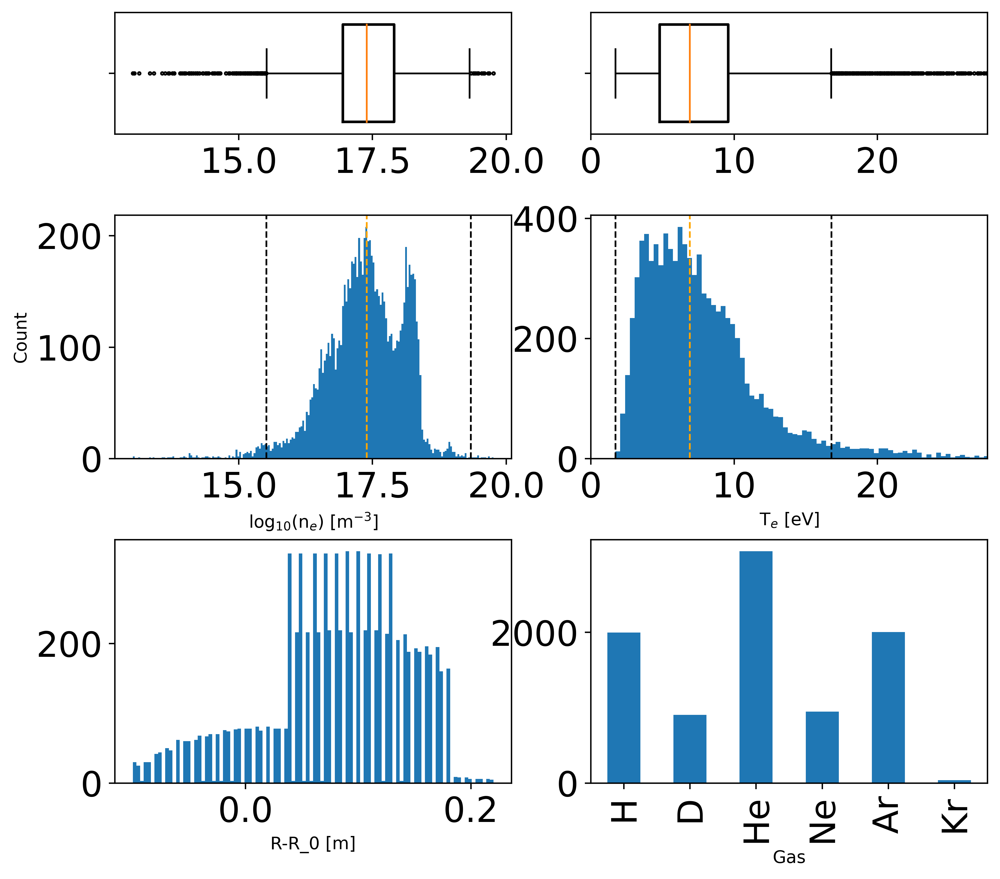

In [164]:

#plot box plots of ne and Te


# set up the figure
fig, ax = plt.subplots(3,2, figsize=(9,8), dpi=500,gridspec_kw = {'height_ratios':[1,2,2]})
# set the font size
plt.xticks()
plt.yticks()
# set the title
#plt.title('Histogram of ne and Te')
# set the axis labels
# set 0,0 to log scale

ax[1,0].set_xlabel('log$_{10}$(n$_e$) [m$^{-3}$]')
  #1et to log scale
#ax10,0].set_xscale('log')
ax[1,0].set_ylabel('Count')
ax[1,1].set_xlabel('T$_e$ [eV]')
ax[2,0].set_xlabel('R-R_0 [m]')
#ax[1].set_ylabel('Count' )

ax[1,0].hist(np.log10(all_data['ne']), bins = 200)

# p1,0ot mean and std lines
#ax[1,0].axvline(np.log10(mean_ne), color='k', linestyle='dashed', linewidth=1, label = 'mean')
ax[1,0].axvline(np.log10(median_ne), color='orange', linestyle='dashed', linewidth=1, label = 'median')
#ax[0,0].axvline(mean_ne + std_ne, color='k', linestyle='dashed', linewidth=1, label = 'std')



# cal iqr for ne and te
q75, q25 = np.percentile(np.log10(all_data['ne']), [75 ,25])
iqr = q75 - q25
print('iqr ne: ', iqr)
# plot 1.5*iqr lines
ax[1,0].axvline((q75 + 1.5*iqr), color='k', linestyle='dashed', linewidth=1)
ax[1,0].axvline((q25 - 1.5*iqr), color='k', linestyle='dashed', linewidth=1)
print('ne outlier limit' , q75 + 1.5*iqr)
print('ne lower limit' , q25 - 1.5*iqr)
# same for te   
q75, q25 = np.percentile(all_data['Te'], [75 ,25])
iqr = q75 - q25
print('iqr te: ', iqr)
# plot 1.5*iqr lines
ax[1,1].axvline(q75 + 1.5*iqr, color='k', linestyle='dashed', linewidth=1)
ax[1,1].axvline(q25 - 1.5*iqr, color='k', linestyle='dashed', linewidth=1)
print('te outlier limit' , q75 + 1.5*iqr)
print('te lower limit' , q25 - 1.5*iqr)


# make x scale log
#increase spacing between subplots
plt.subplots_adjust(hspace=0.4)

ax[1,1].hist(all_data['Te'], bins = 500)
# p1,1ot mean and std lines
#ax[1,1].axvline(mean_te, color='k', linestyle='dashed', linewidth=1, label = 'mean')
ax[1,1].axvline(median_te, color='orange', linestyle='dashed', linewidth=1, label = 'median')
#ax[0,1].axvline(mean_te + std_te, color='k', linestyle='dashed', linewidth=1, label = 'std')
#ax[1].axvline(mean_te - std_te, color='k', linestyle='dashed', linewidth=1)

# choose x limits to show 99% of the data on the plot. start by sorting the data
sorted_te = np.sort(all_data['Te'])
sorted_ne = np.sort(all_data['ne'])
# get the index of the 99% value
index_te = int(len(sorted_te)*0.99)
index_ne = int(len(sorted_ne)*0.99)
# get the value of the 99% value
val_te = sorted_te[index_te]
val_ne = sorted_ne[index_ne]
# set the x limits
ax[1,1].set_xlim(0, val_te)
#ax[0,0].set_xlim(0, val_ne)

# add final axis for R_0
ax[2,0].hist(all_data['R_0'], bins = 100  )
# p2ot mean and std lines


flierprops = dict(marker='o', markersize=1.5, linestyle='none')
boxprops = dict(linewidth=1.5)
ax[0,0].boxplot(np.log10(all_data['ne']), vert=False, flierprops=flierprops, boxprops=boxprops, widths=0.8)
ax[0,1].boxplot(all_data['Te'], vert=False, flierprops=flierprops, boxprops=boxprops,widths=.8)
# get wisker values
whis_ne = ax[0,0].get_lines()[4].get_ydata()
whis_te = ax[0,1].get_lines()[4].get_xdata()
print('whis_te: ', whis_te)
# get lower and upper whisker values
lower_whis_te = whis_te[0]
upper_whis_te = whis_te[1]
print('lower_whis_te: ', lower_whis_te)
print('upper_whis_te: ', upper_whis_te)


ax[0,1].set_xlim(0, val_te)
ax[0,0].set_yticklabels([])
ax[0,1].set_yticklabels([])


ax[0,1] = all_data['gas_name'].value_counts().loc[['H', 'D', 'He', 'Ne', 'Ar', 'Kr']].plot.bar()
ax[0,1].set_xlabel('Gas')
#get lowest value of te
min_te = np.min(all_data['Te'])
#plot line at min te
ax[1,1].axvline(min_te, color='k', linestyle='dashed', linewidth=1)
print('min_te: ', min_te)






c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical

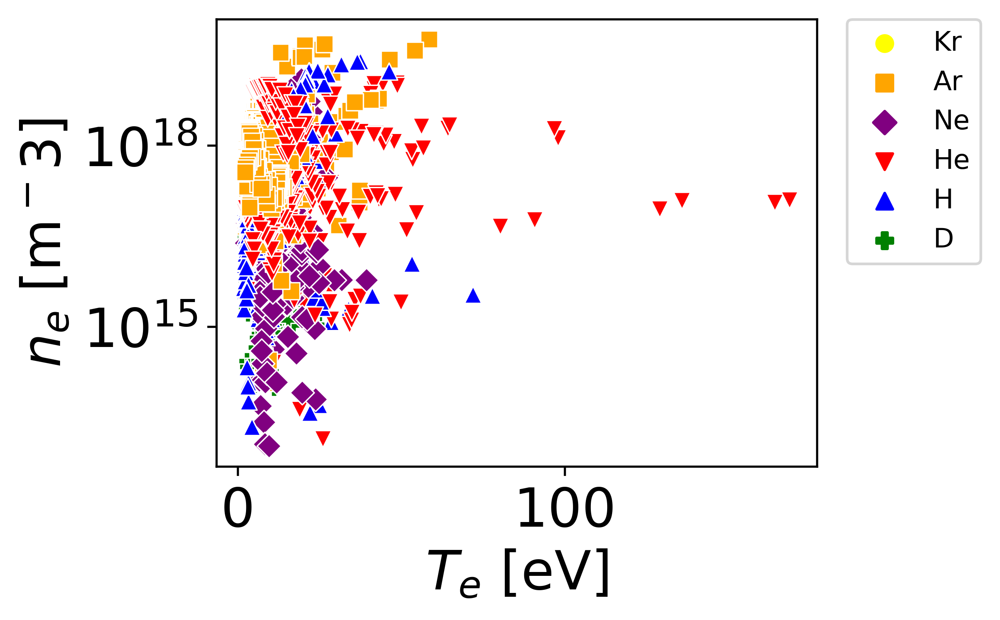

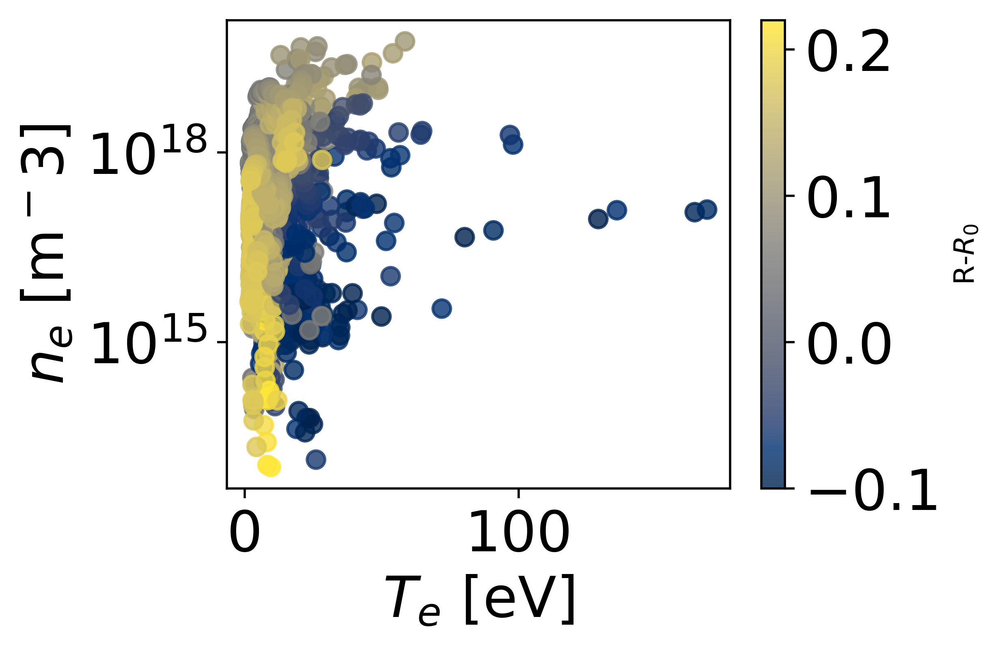

In [165]:
gas_colors = {'H': 'blue', 'D': 'green', 'He': 'red', 'Ne': 'purple', 'Ar': 'orange', 'Kr': 'yellow'}
# set icon shape
gas_shapes = ['o', 's', 'D', 'v', '^', 'P']

gas = ['H', 'D', 'He', 'Ne', 'Ar', 'Kr']
fontsize = 20
dpi = 500
# set fig size
plt.figure(figsize=(4, 3), dpi=dpi)
sns.scatterplot(data=all_data, x='Te', y='ne', hue='gas_name', palette=gas_colors, style='gas_name', markers=gas_shapes, s=40)
plt.xlabel('$T_e$ [eV]', fontsize = fontsize)
plt.ylabel('$n_e$ [m$^-3$]', fontsize = fontsize)
plt.xticks(fontsize = fontsize)
#increase y ticks size
plt.yticks(fontsize = fontsize)
#make y log scale
plt.yscale('log')
# put legend outside of plot
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
#plt.title('ne vs te')
import matplotlib 
import matplotlib.colors as mcolors
import matplotlib.cm as cm
cmap = 'hsv'
cmap = matplotlib.cm.get_cmap('cividis').copy()

colors1 = plt.cm.inferno(np.linspace(0., 0.5, 128))
colors2 = plt.cm.viridis(np.linspace(0, .5, 106))

# combine them and build a new colormap
colors = np.vstack((colors1[:22:-1], colors2[4:]))
mymap = mcolors.LinearSegmentedColormap.from_list('my_colormap', colors[::-1])
mymap = 'viridis'



plt.figure(figsize=(4, 3), dpi=dpi)
#increase x ticks size

plt.scatter(all_data['Te'],all_data['ne'], c=all_data['R_0'],cmap=cmap, alpha=0.8, s = 40)#,edgecolors = 'white' )
plt.xlabel('$T_e$ [eV]', fontsize = fontsize)
plt.ylabel('$n_e$ [m$^-3$]', fontsize = fontsize)
#plt.title('Ranges of $T_e$ and $R_0$ with \n effective R-$R_0$', fontsize = fontsize)
plt.yscale('log')
cbar = 'R-$R_0$'
plt.xticks(fontsize = fontsize)
#increase y ticks size
plt.yticks(fontsize = fontsize)
plt.colorbar(label=cbar)

# redo this plot but using subfigures and share the y axis



c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical

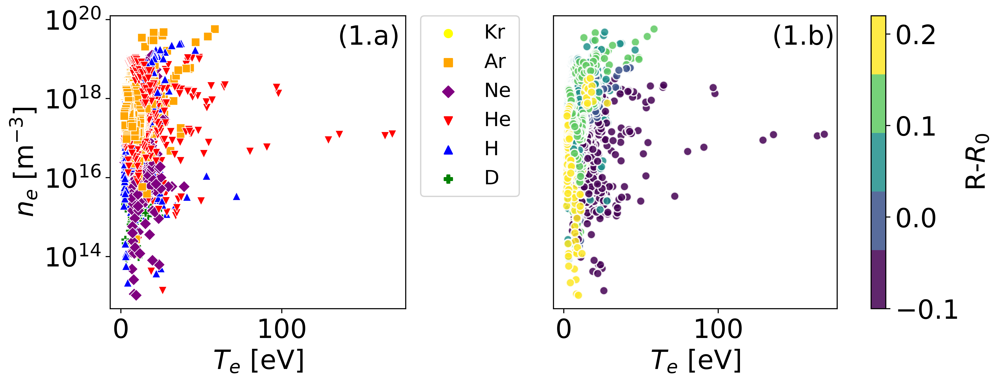

c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical

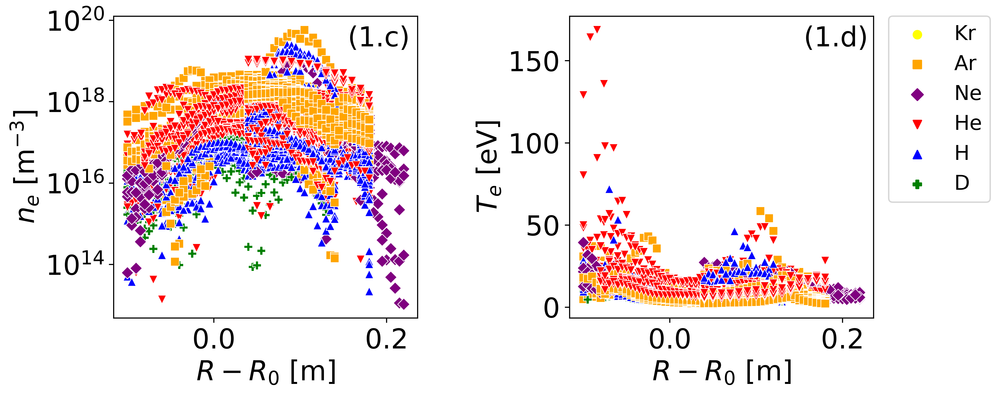

In [166]:
# Define gas colors and shapes
gas_colors = {'H': 'blue', 'D': 'green', 'He': 'red', 'Ne': 'purple', 'Ar': 'orange', 'Kr': 'yellow'}
gas_shapes = ['o', 's', 'D', 'v', '^', 'P']
gas = ['H', 'D', 'He', 'Ne', 'Ar', 'Kr']

# Set figure size and dpi
fig = plt.figure(figsize=(10, 4), dpi=500)

# Create subplots
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2, sharey=ax1)

# Plot on the first subplot
sns.scatterplot(data=all_data, x='Te', y='ne', hue='gas_name', palette=gas_colors,
                style='gas_name', markers=gas_shapes, s=40, ax=ax1)
ax1.set_xlabel('$T_e$ [eV]', fontsize=20)
ax1.set_ylabel('$n_e$ [m$^{-3}$]', fontsize=20)
ax1.tick_params(axis='both', which='both', labelsize=20)
ax1.set_yscale('log')
ax1.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=15)
# set ticks to be more frequent

# make cbar rainbow
cmap = plt.cm.get_cmap('viridis', 5)


# Plot on the second subplot
sc = ax2.scatter(all_data['Te'], all_data['ne'], c=all_data['R_0'], cmap=cmap, alpha=0.85, s=40, edgecolors='white')
ax2.set_xlabel('$T_e$ [eV]', fontsize=20)
#ax2.set_ylabel('$n_e$ [m$^{-3}$]', fontsize=20)
ax2.tick_params(axis='both', which='both', labelsize=20)
# turn off y ticks
ax2.tick_params(axis='y', which='both', left=False, labelleft=False)
ax2.set_yscale('log')
cbar = fig.colorbar(sc, ax=ax2)
cbar.set_label('R-$R_0$', fontsize=20)

# Adjust subplots spacing
plt.subplots_adjust(wspace=0.5)
# increase the size of the plot of ax2
box = ax2.get_position()
ax2.set_position([box.x0, box.y0, box.width * 1.2, box.height])
#move colour bar furhter to the right
box = cbar.ax.get_position()
cbar.ax.set_position([box.x0 + box.width * 1.5, box.y0, box.width * 0.5, box.height])


#provide a and b labels
ax1.text(0.77, 0.97, '(1.a)', transform=ax1.transAxes, fontsize=20, va='top')
ax2.text(0.77, 0.97, '(1.b)', transform=ax2.transAxes, fontsize=20, va='top')


# Show the plot
plt.show()

# Define gas colors and shapes
gas_colors = {'H': 'blue', 'D': 'green', 'He': 'red', 'Ne': 'purple', 'Ar': 'orange', 'Kr': 'yellow'}
gas_shapes = ['o', 's', 'D', 'v', '^', 'P']
gas = ['H', 'D', 'He', 'Ne', 'Ar', 'Kr']

# Set figure size and dpi
fig = plt.figure(figsize=(10, 4), dpi=600)

# Create subplots
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2                      )

# Plot on the first subplot
sns.scatterplot(data=all_data, x='R_0', y='ne', hue='gas_name', palette=gas_colors,
                style='gas_name', markers=gas_shapes, s=40, ax=ax1)
ax1.set_xlabel('$R-R_0$ [m]', fontsize=20)
ax1.set_ylabel('$n_e$ [m$^{-3}$]', fontsize=20)
ax1.tick_params(axis='both', which='both', labelsize=20)
ax1.set_yscale('log')
#ax1.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=15)
# set ticks to be more frequent
# turn off legens##
ax1.legend().remove()

# make cbar rainbow
cmap = 'hsv'

sns.scatterplot(data=all_data, x='R_0', y='Te', hue='gas_name', palette=gas_colors,
                style='gas_name', markers=gas_shapes, s=40, ax=ax2)
ax2.set_xlabel('$R-R_0$ [m]', fontsize=20)
ax2.set_ylabel('$T_e$ [eV]', fontsize=20)
ax2.tick_params(axis='both', which='both', labelsize=20)

ax2.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=15)
# Adjust subplots spacing
plt.subplots_adjust(wspace=0.5)
# increase the size of the plot of ax2
box = ax2.get_position()
ax2.set_position([box.x0, box.y0, box.width * 1, box.height])
#move colour bar furhter to the right
box = cbar.ax.get_position()
cbar.ax.set_position([box.x0 + box.width * 1.5, box.y0, box.width * 0.5, box.height])


#provide a and b labels
ax1.text(0.77, 0.97, '(1.c)', transform=ax1.transAxes, fontsize=20, va='top')
ax2.text(0.77, 0.97, '(1.d)', transform=ax2.transAxes, fontsize=20, va='top')


# Show the plot
plt.show()



In [167]:
#keep full original dataset of all data and IV_df_x for later use
all_data_copy = all_data.copy()
IV_df_x_copy = IV_df_x.copy()

## REmove bad shots from the dataset


In [168]:
# remove shots[13088, 13221, 13123] from the dataset as they are outliers
'''
outlier_shots = [13088, 13221, 13123, 13089, 13090, 13091, 
                 13092, 19093, 13094, 13095, 13096, 13064, 
                 13232,13244,10294,2820,2800,13319]


# find the index of the shots in the dataset
outlier_index = all_data.loc[all_data['shot'].isin(outlier_shots)].index
# drop the shots from the dataset
all_data = all_data.drop(outlier_index)
IV_df_x = IV_df_x.drop(outlier_index)
# reset the index
all_data = all_data.reset_index(drop=True)
IV_df_x = IV_df_x.reset_index(drop=True)

'''


"\noutlier_shots = [13088, 13221, 13123, 13089, 13090, 13091, \n                 13092, 19093, 13094, 13095, 13096, 13064, \n                 13232,13244,10294,2820,2800,13319]\n\n\n# find the index of the shots in the dataset\noutlier_index = all_data.loc[all_data['shot'].isin(outlier_shots)].index\n# drop the shots from the dataset\nall_data = all_data.drop(outlier_index)\nIV_df_x = IV_df_x.drop(outlier_index)\n# reset the index\nall_data = all_data.reset_index(drop=True)\nIV_df_x = IV_df_x.reset_index(drop=True)\n\n"

iqr ne:  0.9549848232072939
ne outlier limit 19.335214192867248
ne lower limit 15.51527490003807
iqr te:  4.788203
te outlier limit 16.7768045
te lower limit -2.376007500000001
whis_te:  [16.76 16.76]
lower_whis_te:  16.76
upper_whis_te:  16.76
min_te:  1.718


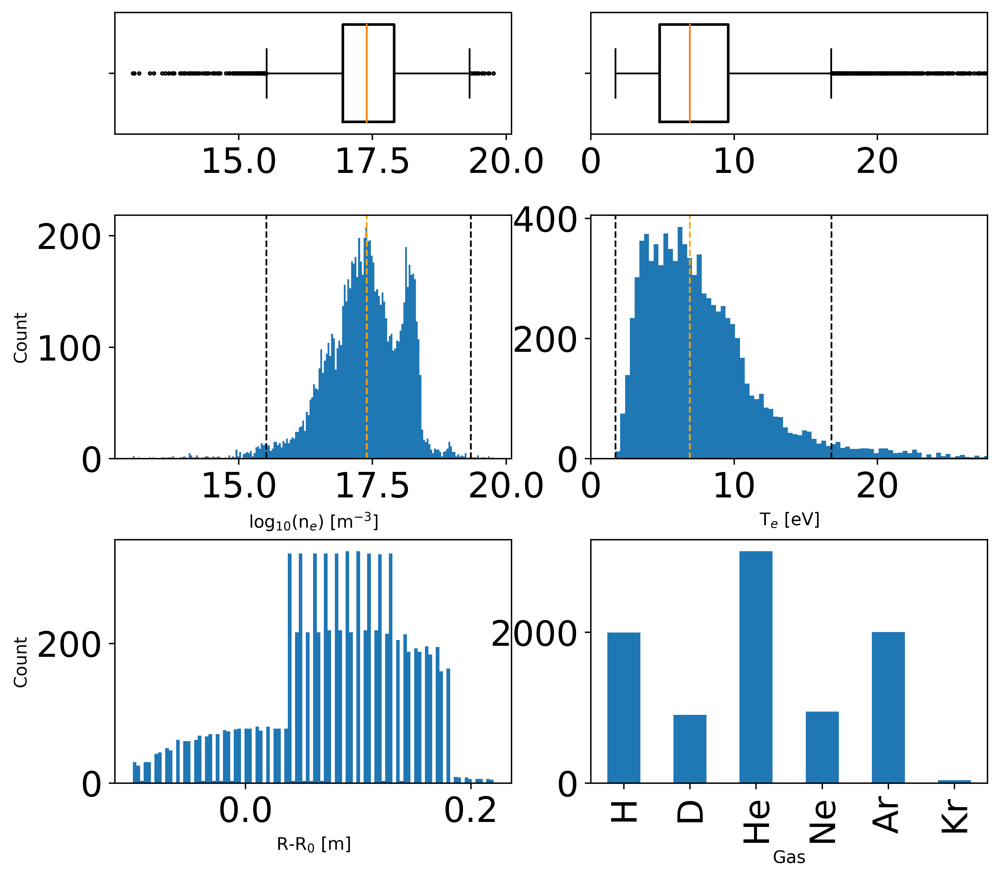

In [169]:

#plot box plots of ne and Te


# set up the figure
fig, ax = plt.subplots(3,2, figsize=(9,8), dpi=500,gridspec_kw = {'height_ratios':[1,2,2]})
# set the font size
# make space between row 0 and 1 smaller
fig.subplots_adjust(hspace=0)


plt.xticks()
plt.yticks()
# set the title
#plt.title('Histogram of ne and Te')
# set the axis labels
# set 0,0 to log scale

ax[1,0].set_xlabel('log$_{10}$(n$_e$) [m$^{-3}$]')
  #1et to log scale
#ax10,0].set_xscale('log')
ax[1,0].set_ylabel('Count')
ax[1,1].set_xlabel('T$_e$ [eV]')
ax[2,0].set_xlabel('R-R_0 [m]')
#ax[1].set_ylabel('Count' )

ax[1,0].hist(np.log10(all_data['ne']), bins = 200)

# p1,0ot mean and std lines
#ax[1,0].axvline(np.log10(mean_ne), color='k', linestyle='dashed', linewidth=1, label = 'mean')
ax[1,0].axvline(np.log10(median_ne), color='orange', linestyle='dashed', linewidth=1, label = 'median')
#ax[0,0].axvline(mean_ne + std_ne, color='k', linestyle='dashed', linewidth=1, label = 'std')



# cal iqr for ne and te
nq75, nq25 = np.percentile(np.log10(all_data['ne']), [75 ,25])
niqr = nq75 - nq25
print('iqr ne: ', niqr)
# plot 1.5*iqr lines
ax[1,0].axvline((nq75 + 1.5*niqr), color='k', linestyle='dashed', linewidth=1)
ax[1,0].axvline((nq25 - 1.5*niqr), color='k', linestyle='dashed', linewidth=1)
print('ne outlier limit' , nq75 + 1.5*niqr)
print('ne lower limit' , nq25 - 1.5*niqr)
# same for te   
tq75, tq25 = np.percentile(all_data['Te'], [75 ,25])
tiqr = tq75 - tq25
print('iqr te: ', iqr)
# plot 1.5*iqr lines
ax[1,1].axvline(tq75 + 1.5*tiqr, color='k', linestyle='dashed', linewidth=1)
ax[1,1].axvline(tq25 - 1.5*tiqr, color='k', linestyle='dashed', linewidth=1)
print('te outlier limit' , tq75 + 1.5*tiqr)
print('te lower limit' , tq25 - 1.5*iqr)


# make x scale log
#increase spacing between subplots
plt.subplots_adjust(hspace=0.4)

ax[1,1].hist(all_data['Te'], bins = 500)
# p1,1ot mean and std lines
#ax[1,1].axvline(mean_te, color='k', linestyle='dashed', linewidth=1, label = 'mean')
ax[1,1].axvline(median_te, color='orange', linestyle='dashed', linewidth=1, label = 'median')
#ax[0,1].axvline(mean_te + std_te, color='k', linestyle='dashed', linewidth=1, label = 'std')
#ax[1].axvline(mean_te - std_te, color='k', linestyle='dashed', linewidth=1)

# choose x limits to show 99% of the data on the plot. start by sorting the data
sorted_te = np.sort(all_data['Te'])
sorted_ne = np.sort(all_data['ne'])
# get the index of the 99% value
index_te = int(len(sorted_te)*0.99)
index_ne = int(len(sorted_ne)*0.99)
# get the value of the 99% value
val_te = sorted_te[index_te]
val_ne = sorted_ne[index_ne]
# set the x limits
ax[1,1].set_xlim(0, val_te)
#ax[0,0].set_xlim(0, val_ne)

# add final axis for R_0
ax[2,0].hist(all_data['R_0'], bins = 100  )
# x label
ax[2,0].set_xlabel('R-R$_0$ [m]')
# p2ot mean and std lines


flierprops = dict(marker='o', markersize=1.5, linestyle='none')
boxprops = dict(linewidth=1.5)
ax[0,0].boxplot(np.log10(all_data['ne']), vert=False, flierprops=flierprops, boxprops=boxprops, widths=0.8)
ax[0,1].boxplot(all_data['Te'], vert=False, flierprops=flierprops, boxprops=boxprops,widths=.8)
# get wisker values
whis_ne = ax[0,0].get_lines()[4].get_ydata()
whis_te = ax[0,1].get_lines()[4].get_xdata()
print('whis_te: ', whis_te)
# get lower and upper whisker values
lower_whis_te = whis_te[0]
upper_whis_te = whis_te[1]
print('lower_whis_te: ', lower_whis_te)
print('upper_whis_te: ', upper_whis_te)


ax[0,1].set_xlim(0, val_te)
ax[0,0].set_yticklabels([])
ax[0,1].set_yticklabels([])
ax[2,0].set_ylabel('Count')


ax[0,1] = all_data['gas_name'].value_counts().loc[['H', 'D', 'He', 'Ne', 'Ar', 'Kr']].plot.bar()
ax[0,1].set_xlabel('Gas')
#get lowest value of te
min_te = np.min(all_data['Te'])
#plot line at min te
ax[1,1].axvline(min_te, color='k', linestyle='dashed', linewidth=1)
print('min_te: ', min_te)

pre_all = all_data




## Remove a whole shot for later analysis

Predicting the parameters of a whole shot can show that the model is robust enough for full profile prediction. 

In [170]:
len(all_data)

8971

In [171]:
pop_shot_bool = True
if pop_shot_bool == True:
    # pick random shot numbers from the dataset
    # get the shot numbers
    shotnos = all_data['shot'].unique()
    # get 2 random shot numbers per gas
    shot_pop = np.array([])
    # get list of original gasses
    gas = all_data['gas_name'].unique()
    # loop through each gas
    
    for i in range(len(gas)):
        # get the shot numbers for each gas
        shotnos_gas = all_data.loc[all_data['gas_name'] == gas[i]]['shot'].unique()
        # get 2 random shot numbers per gas
        # use seed to get the same random numbers each time
        np.random.seed(0)
        shot_pop = np.append(shot_pop, np.random.choice(shotnos_gas, 2, replace=False))

    shot_pop = np.append(shot_pop, 13101)
    shot_pop = np.append(shot_pop, 13102)
    shot_pop = np.append(shot_pop, 13103)
    shot_pop = np.append(shot_pop, 13104)
    shot_pop = np.append(shot_pop, 13316)
    shot_pop = np.append(shot_pop, 2931)
    shot_pop = np.append(shot_pop, 13247)
    shot_pop = np.append(shot_pop, 13288)
    shot_pop = np.append(shot_pop, 13221)
    shot_pop = np.append(shot_pop, 13123)
    shot_pop = np.append(shot_pop, 13089)
    shot_pop = np.append(shot_pop, 13088)

    '''
    shot_pop = np.append(shot_pop, 13088)
    shot_pop = np.append(shot_pop, 13089)
    shot_pop = np.append(shot_pop, 13090)
    shot_pop = np.append(shot_pop, 13091)
    shot_pop = np.append(shot_pop, 13092)
    shot_pop = np.append(shot_pop, 13093)
    shot_pop = np.append(shot_pop, 13094)
    shot_pop = np.append(shot_pop, 13095)
    shot_pop = np.append(shot_pop, 13096)
    shot_pop = np.append(shot_pop, 13097)
    '''
    print(shot_pop)


    #==============================================================================
    # pop one shot from the dataset using function popOneShot
    IV_df_x, all_data, IV_Test_X, IV_Test_y, all_data_test = popOneShot(IV_df_x, shot_pop, all_data)
    #==============================================================================
    print('Number of nan values in the dataset y: ', all_data['ne'].isnull().sum().sum())
    print('Number of nan values in the dataset X: ', IV_df_x.isnull().sum().sum())


    IV_Test_X.reset_index(drop=True, inplace=True)
    IV_Test_y.reset_index(drop=True, inplace=True)
    all_data_test.reset_index(drop=True, inplace=True)

    all_data.reset_index(drop=True, inplace=True)
    IV_df_x.reset_index(drop=True, inplace=True)


    print('-----------------------------------')
    # print size of IV_Test_X, IV_Test_y
    print('IV_Test_X size: ', IV_Test_X.shape)
    print('IV_Test_y size: ', IV_Test_y.shape)

[10261. 10262. 13283. 13287. 10289. 13082.  2816. 13260. 13220. 13225.
 11180.  2812. 13101. 13102. 13103. 13104. 13316.  2931. 13247. 13288.
 13221. 13123. 13089. 13088.]
Number of nan values in the dataset y:  0
Number of nan values in the dataset X:  0
-----------------------------------
IV_Test_X size:  (729, 201)
IV_Test_y size:  (729, 2)


In [172]:
len(all_data)

8242

## Finding outliers in the data
False measurements can ruin the model. in shot 28000 it seems that the Te has been mistyped as 69650 keV which is distorting the model. We will delete this row.

Data is also scewed. Put of 4224 IV curves, only 4 are between 60-180 keV. This scews the data and these rows can be removed

In [173]:
filter_bool = False # due to pandas update, filter no longer workds 

In [174]:
#pass all of the data through the filtered derivative function
def IV_filter(IV_df_x,all_data): 
    max_der = []
    filtered_dr = []
    filteredI = []
    for i in range(0, len(IV_df_x)):
        maxDR, dydx , filtered= filtered_derivative(IV_df_x.iloc[i,:], win_length = 10)
        max_der.append(maxDR)
        #OLD VERSION OF PANDAS
        #filtered_dr = filtered_dr.append(pd.DataFrame(dydx).T)
        #filteredI = filteredI.append(pd.DataFrame(filtered).T)
        # use concat instead of append
        filtered_dr.append(pd.DataFrame(dydx).T)
        filteredI.append(pd.DataFrame(filtered).T)
        print(filtered_dr)


    #make max der
    # pass filtereddr through find_local_maximum
    max_der_index2 = []
    for i in range(0, len(filtered_dr)):
        #max_der_index2.append(find_local_maximum(filtered_dr.iloc[i,:], 0.021467638287332644))
        # replace append with concat
        max_der_index2 = pd.concat([max_der_index2, pd.DataFrame(find_local_maximum(filtered_dr.iloc[i,:], 0.021467638287332644))], ignore_index=True)

    #print('how mant nan values in max_der_index2: ', np.isnan(max_der_index2).sum())
    #get index of nan values
    nan_index = np.argwhere(np.isnan(max_der_index2))
    ##print('index of nan values: ', nan_index[:5])
    # make nanindex a list
    nan_index = nan_index.flatten()
    #print('index of nan values: ', nan_index[:5])
    print('No shots to be removed from intergral filter: ', len(nan_index))


    all_data = all_data.drop(nan_index)
    IV_df_x = IV_df_x.drop(nan_index)
    #reset index
    all_data = all_data.reset_index(drop=True)
    IV_df_x = IV_df_x.reset_index(drop=True)




    # get index with I values less than -1 . search range IV_df_x[:,I_range] to get the row
    # where I is less than -1
    Idf = IV_df_x.iloc[:,I_range]
    # get the index of the row where any value in the row is less than -1
    I_less_than_1 = Idf[(Idf < -1).any(axis=1)].index
    print('shots removed by no saturation:',len(I_less_than_1))

    # remove shots with I less than -1
    all_data = all_data.drop(I_less_than_1)
    IV_df_x = IV_df_x.drop(I_less_than_1)
    #reset index
    all_data = all_data.reset_index(drop=True)
    IV_df_x = IV_df_x.reset_index(drop=True)
    return IV_df_x,all_data,filtered_dr,filteredI



In [175]:
if filter_bool == True:
    # pass all of the data through the filtered derivative function
    IV_df_x,all_data,filtered_dr,filteredI = IV_filter(IV_df_x,all_data)

In [176]:
# Chooose to remove the outliers or not
remove_outliers = True

In [177]:
if remove_outliers == True:
    IV_df_x, all_data = removeOutliers(IV_df_x, all_data, True, False) # hard limits and IQR data removal set to false
    # remove shots with the index max_der_index from flat IVS


    
    
    '''
    startlen = len(all_data)
    # identify outliers in the training dataset
    lof = LocalOutlierFactor()
    yhat = lof.fit_predict(IV_df_x)
    # select all rows that are not outliers
    mask = yhat != -1

    #save outliers for later 
    outliers_for_test = all_data[~mask]
    IV_df_x = IV_df_x[mask]
    all_data = all_data[mask]
    # summarize the shape of the updated training dataset
    print(IV_df_x.shape, all_data.shape)
    print('Removed {} outliers'.format(startlen - len(all_data)))
    '''
    # reset index
    IV_df_x = IV_df_x.reset_index(drop=True)
    all_data = all_data.reset_index(drop=True)
    '''
    #------------------#
    # open outliers_02.csv and append the outliers from the training set
    #------------------#
    # open the file andfirst line as header
    # using ID column, remove the rows with the same ID from IV_df_x and all_data
    #len before removing outliers
    print('len before removing outliers: {}'.format(len(all_data)))
    # get index of outliers from all_data using the ID column in outliers_02.csv
    outliers_ind = all_data[all_data['ID'].isin(outliers['ID'])].index
    # drop the outliers from all_data and IV_df_x
    all_data = all_data.drop(outliers_ind)
    IV_df_x = IV_df_x.drop(outliers_ind)
    #reset index
    all_data = all_data.reset_index(drop=True)
    IV_df_x = IV_df_x.reset_index(drop=True)

    #len after removing outliers
    print('len after removing outliers: {}'.format(len(all_data)))
    # pring outliers removed
    print('Removed {} outliers'.format(len(outliers)))
    '''
    


Number of outlier parameters Te>20eV: 365
Number of outlier parameters ne<10^15: 163
Number of outlier parameters ne>10^19: 3
Number of outlier parameters R0<-0.05: 389
Number of outlier parameters R0>0.18: 51
Number of IVs to be removed: 693


c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical

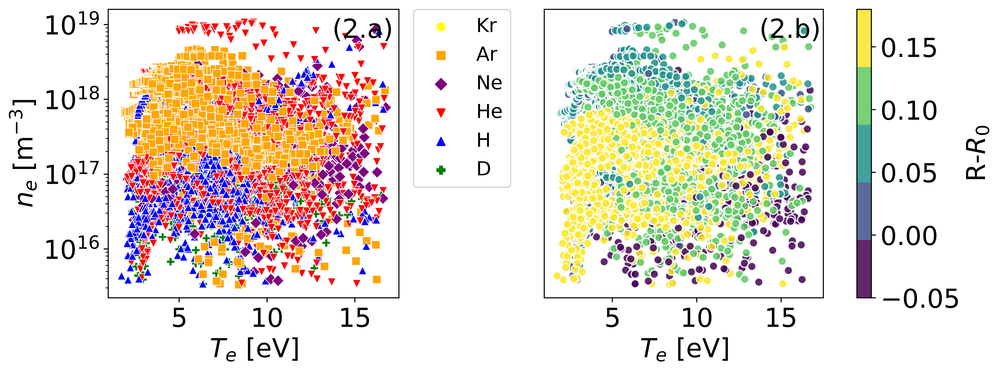

c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\ikejjosh\venv\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical

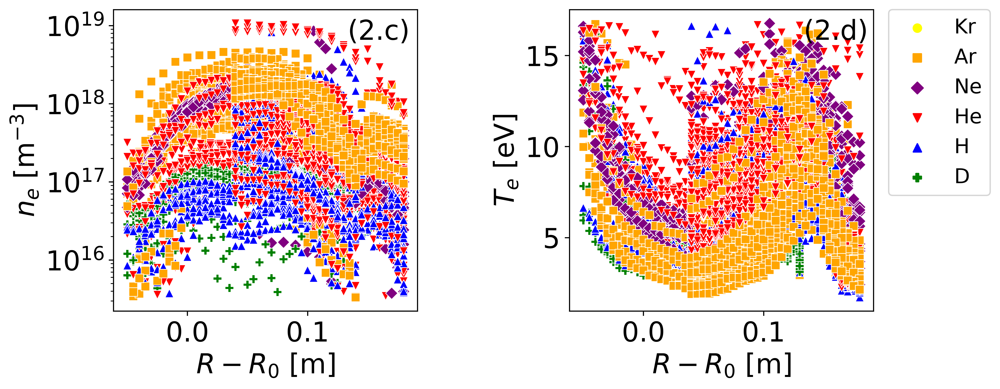

In [178]:
# Define gas colors and shapes
gas_colors = {'H': 'blue', 'D': 'green', 'He': 'red', 'Ne': 'purple', 'Ar': 'orange', 'Kr': 'yellow'}
gas_shapes = ['o', 's', 'D', 'v', '^', 'P']
gas = ['H', 'D', 'He', 'Ne', 'Ar', 'Kr']

# Set figure size and dpi
fig = plt.figure(figsize=(10, 4), dpi=500)

# Create subplots
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2, sharey=ax1)

# Plot on the first subplot
sns.scatterplot(data=all_data, x='Te', y='ne', hue='gas_name', palette=gas_colors,
                style='gas_name', markers=gas_shapes, s=40, ax=ax1)
ax1.set_xlabel('$T_e$ [eV]', fontsize=20)
ax1.set_ylabel('$n_e$ [m$^{-3}$]', fontsize=20)
ax1.tick_params(axis='both', which='both', labelsize=20)
ax1.set_yscale('log')
ax1.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=15)
# set ticks to be more frequent

# make cbar rainbow
cmap = plt.cm.get_cmap('viridis', 5)


# Plot on the second subplot
sc = ax2.scatter(all_data['Te'], all_data['ne'], c=all_data['R_0'], cmap=cmap, alpha=0.85, s=40, edgecolors='white')
ax2.set_xlabel('$T_e$ [eV]', fontsize=20)
#ax2.set_ylabel('$n_e$ [m$^{-3}$]', fontsize=20)
ax2.tick_params(axis='both', which='both', labelsize=20)
# turn off y ticks
ax2.tick_params(axis='y', which='both', left=False, labelleft=False)
ax2.set_yscale('log')
cbar = fig.colorbar(sc, ax=ax2)
cbar.set_label('R-$R_0$', fontsize=20)

# Adjust subplots spacing
plt.subplots_adjust(wspace=0.5)
# increase the size of the plot of ax2
box = ax2.get_position()
ax2.set_position([box.x0, box.y0, box.width * 1.2, box.height])
#move colour bar furhter to the right
box = cbar.ax.get_position()
cbar.ax.set_position([box.x0 + box.width * 1.5, box.y0, box.width * 0.5, box.height])


#provide a and b labels
ax1.text(0.77, 0.97, '(2.a)', transform=ax1.transAxes, fontsize=20, va='top')
ax2.text(0.77, 0.97, '(2.b)', transform=ax2.transAxes, fontsize=20, va='top')


# Show the plot
plt.show()

# Define gas colors and shapes
gas_colors = {'H': 'blue', 'D': 'green', 'He': 'red', 'Ne': 'purple', 'Ar': 'orange', 'Kr': 'yellow'}
gas_shapes = ['o', 's', 'D', 'v', '^', 'P']
gas = ['H', 'D', 'He', 'Ne', 'Ar', 'Kr']

# Set figure size and dpi
fig = plt.figure(figsize=(10, 4), dpi=600)

# Create subplots
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2                      )

# Plot on the first subplot
sns.scatterplot(data=all_data, x='R_0', y='ne', hue='gas_name', palette=gas_colors,
                style='gas_name', markers=gas_shapes, s=40, ax=ax1)
ax1.set_xlabel('$R-R_0$ [m]', fontsize=20)
ax1.set_ylabel('$n_e$ [m$^{-3}$]', fontsize=20)
ax1.tick_params(axis='both', which='both', labelsize=20)
ax1.set_yscale('log')
#ax1.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=15)
# set ticks to be more frequent
# turn off legens##
ax1.legend().remove()

# make cbar rainbow
cmap = 'hsv'

sns.scatterplot(data=all_data, x='R_0', y='Te', hue='gas_name', palette=gas_colors,
                style='gas_name', markers=gas_shapes, s=40, ax=ax2)
ax2.set_xlabel('$R-R_0$ [m]', fontsize=20)
ax2.set_ylabel('$T_e$ [eV]', fontsize=20)
ax2.tick_params(axis='both', which='both', labelsize=20)

ax2.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=15)
# Adjust subplots spacing
plt.subplots_adjust(wspace=0.5)
# increase the size of the plot of ax2
box = ax2.get_position()
ax2.set_position([box.x0, box.y0, box.width * 1, box.height])
#move colour bar furhter to the right
box = cbar.ax.get_position()
cbar.ax.set_position([box.x0 + box.width * 1.5, box.y0, box.width * 0.5, box.height])


#provide a and b labels
ax1.text(0.77, 0.97, '(2.c)', transform=ax1.transAxes, fontsize=20, va='top')
ax2.text(0.77, 0.97, '(2.d)', transform=ax2.transAxes, fontsize=20, va='top')


# Show the plot
plt.show()



In [179]:
len(all_data)

7549

iqr ne:  0.9549848232072939
ne outlier limit 19.335214192867248
ne lower limit 15.51527490003807
iqr te:  4.788203
te outlier limit 16.7768045
te lower limit -2.376007500000001
whis_te:  [15.45 15.45]
lower_whis_te:  15.45
upper_whis_te:  15.45
min_te:  1.718


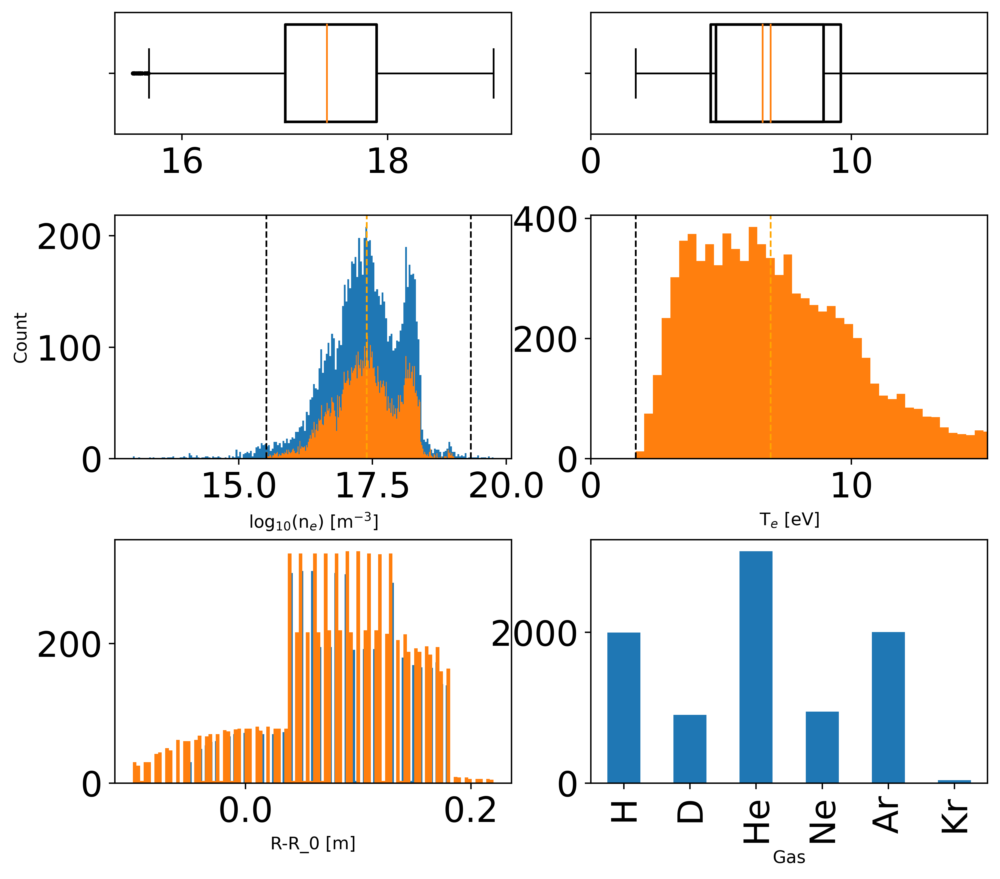

In [180]:

#plot box plots of ne and Te


# set up the figure
fig, ax = plt.subplots(3,2, figsize=(9,8), dpi=500,gridspec_kw = {'height_ratios':[1,2,2]})
# set the font size
plt.xticks()
plt.yticks()
# set the title
#plt.title('Histogram of ne and Te')
# set the axis labels
# set 0,0 to log scale

ax[1,0].set_xlabel('log$_{10}$(n$_e$) [m$^{-3}$]')
  #1et to log scale
#ax10,0].set_xscale('log')
ax[1,0].set_ylabel('Count')
ax[1,1].set_xlabel('T$_e$ [eV]')
ax[2,0].set_xlabel('R-R_0 [m]')
#ax[1].set_ylabel('Count' )
ax[1,0].hist(np.log10(pre_all['ne']), bins = 200)
ax[1,0].hist(np.log10(all_data['ne']), bins = 200)

# p1,0ot mean and std lines
#ax[1,0].axvline(np.log10(mean_ne), color='k', linestyle='dashed', linewidth=1, label = 'mean')
ax[1,0].axvline(np.log10(median_ne), color='orange', linestyle='dashed', linewidth=1, label = 'median')
#ax[0,0].axvline(mean_ne + std_ne, color='k', linestyle='dashed', linewidth=1, label = 'std')



# cal iqr for ne and te
nq75, nq25 = np.percentile(np.log10(pre_all['ne']), [75 ,25])
niqr = nq75 - nq25
print('iqr ne: ', niqr)
# plot 1.5*iqr lines
ax[1,0].axvline((nq75 + 1.5*niqr), color='k', linestyle='dashed', linewidth=1)
ax[1,0].axvline((nq25 - 1.5*niqr), color='k', linestyle='dashed', linewidth=1)
print('ne outlier limit' , nq75 + 1.5*niqr)
print('ne lower limit' , nq25 - 1.5*niqr)
# same for te   
tq75, tq25 = np.percentile(pre_all['Te'], [75 ,25])
tiqr = tq75 - tq25
print('iqr te: ', iqr)
# plot 1.5*iqr lines
ax[1,1].axvline(tq75 + 1.5*tiqr, color='k', linestyle='dashed', linewidth=1)
ax[1,1].axvline(tq25 - 1.5*tiqr, color='k', linestyle='dashed', linewidth=1)
print('te outlier limit' , tq75 + 1.5*tiqr)
print('te lower limit' , tq25 - 1.5*iqr)


# make x scale log
#increase spacing between subplots
plt.subplots_adjust(hspace=0.4)

ax[1,1].hist(all_data['Te'], bins = 500)
ax[1,1].hist(pre_all['Te'], bins = 500)
# p1,1ot mean and std lines
#ax[1,1].axvline(mean_te, color='k', linestyle='dashed', linewidth=1, label = 'mean')
ax[1,1].axvline(median_te, color='orange', linestyle='dashed', linewidth=1, label = 'median')
#ax[0,1].axvline(mean_te + std_te, color='k', linestyle='dashed', linewidth=1, label = 'std')
#ax[1].axvline(mean_te - std_te, color='k', linestyle='dashed', linewidth=1)

# choose x limits to show 99% of the data on the plot. start by sorting the data
sorted_te = np.sort(all_data['Te'])
sorted_ne = np.sort(all_data['ne'])
# get the index of the 99% value
index_te = int(len(sorted_te)*0.99)
index_ne = int(len(sorted_ne)*0.99)
# get the value of the 99% value
val_te = sorted_te[index_te]
val_ne = sorted_ne[index_ne]
# set the x limits
ax[1,1].set_xlim(0, val_te)
#ax[0,0].set_xlim(0, val_ne)

# add final axis for R_0
ax[2,0].hist(all_data['R_0'], bins = 100  )
ax[2,0].hist(pre_all['R_0'], bins = 100  )
# p2ot mean and std lines


flierprops = dict(marker='o', markersize=1.5, linestyle='none')
boxprops = dict(linewidth=1.5)
ax[0,0].boxplot(np.log10(all_data['ne']), vert=False, flierprops=flierprops, boxprops=boxprops, widths=0.8)
ax[0,1].boxplot(all_data['Te'], vert=False, flierprops=flierprops, boxprops=boxprops,widths=.8)
ax[0,1].boxplot(pre_all['Te'], vert=False, flierprops=flierprops, boxprops=boxprops,widths=.8)
# get wisker values
whis_ne = ax[0,0].get_lines()[4].get_ydata()
whis_te = ax[0,1].get_lines()[4].get_xdata()
print('whis_te: ', whis_te)
# get lower and upper whisker values
lower_whis_te = whis_te[0]
upper_whis_te = whis_te[1]
print('lower_whis_te: ', lower_whis_te)
print('upper_whis_te: ', upper_whis_te)


ax[0,1].set_xlim(0, val_te)
ax[0,0].set_yticklabels([])
ax[0,1].set_yticklabels([])
ax[1,0].set_ylabel('Count')


ax[0,1] = all_data['gas_name'].value_counts().loc[['H', 'D', 'He', 'Ne', 'Ar', 'Kr']].plot.bar()
ax[0,1] = pre_all['gas_name'].value_counts().loc[['H', 'D', 'He', 'Ne', 'Ar', 'Kr']].plot.bar()
ax[0,1].set_xlabel('Gas')
#get lowest value of te
min_te = np.min(all_data['Te'])
#plot line at min te
ax[1,1].axvline(min_te, color='k', linestyle='dashed', linewidth=1)
print('min_te: ', min_te)





In [181]:
# y - OUTPUT DATA of NN
y_df = all_data.loc[:,['ID','shot','ne','Te']]
y_df = y_df.reset_index(drop=True)

# X-INPUT DATA
#Import iv chars gas and position
X = all_data.loc[:,['ID','shot','gas','R_0']]
X.reset_index(drop=True, inplace=True)
IV_df_x.reset_index(drop=True, inplace=True)
# combine IV with gas type and postion
X_df = pd.concat([X,IV_df_x], sort=False, axis = 1)


In [182]:
# SPLIT FOR TESTING AND TRAINING 
print('Data split into testing and training:')
# print x and y shape
print('X_df size: ', X_df.shape)
print('y_df size: ', y_df.shape)
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_df, y_df, test_size=0.2, stratify= X_df['gas'], random_state=2)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.5, stratify= X_test['gas'], random_state=432)
#print('Xdf', X_train)


# get a df of R_0 from X_train and X_test and X_val for later use
pos_train = X_train['R_0']
pos_test = X_test['R_0']
pos_val = X_val['R_0']

y_train_ind = y_train.index
y_test_ind = y_test.index
y_val_ind = y_val.index

y_train_df = y_train.copy()
y_val_df = y_val.copy()

print('X_train size: ', X_train.shape)
print('y_train size: ', y_train.shape)
print('X_val size: ', X_val.shape)
print('y_val size: ', y_val.shape)
print('X_test size: ', X_test.shape)
print('y_test size: ', y_test.shape)

# search for nans
print('X_train nans: ', X_train.isnull().sum().sum())
print('y_train nans: ', y_train.isnull().sum().sum())
print('X_val nans: ', X_val.isnull().sum().sum())
print('y_val nans: ', y_val.isnull().sum().sum())
print('X_test nans: ', X_test.isnull().sum().sum())
print('y_test nans: ', y_test.isnull().sum().sum())



Data split into testing and training:
X_df size:  (7549, 204)
y_df size:  (7549, 4)
X_train size:  (6039, 204)
y_train size:  (6039, 4)
X_val size:  (755, 204)
y_val size:  (755, 4)
X_test size:  (755, 204)
y_test size:  (755, 4)
X_train nans:  0
y_train nans:  0
X_val nans:  0
y_val nans:  0
X_test nans:  0
y_test nans:  0


## Data preprocessing
1. split into Train Validation Test
2. load smoothed IV (running average smoothing) and $n_e$ $T_e$ data
3. Normalise all X and y values with max value in data set and store later for reverse transform
4. Apply PCA to smoothed IV
5. Add in (normallised) gas mass and postion R to input

Fit PCA to ONLY the Training set.

Use the same fitting to transform the validation and test data. 

In [183]:
#reset 
X_train.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)
X_val.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)
y_val.reset_index(drop=True, inplace=True)

# save ID of y_train and y_test and y_val
y_train_ID = y_train['ID']
y_test_ID = y_test['ID']
y_val_ID = y_val['ID']

# drop ID and shot from y_train and y_test and y_val
'''
y_train = y_train.drop(['ID','shot'], axis=1)
y_test = y_test.drop(['ID','shot'], axis=1)
y_val = y_val.drop(['ID','shot'], axis=1)
'''

"\ny_train = y_train.drop(['ID','shot'], axis=1)\ny_test = y_test.drop(['ID','shot'], axis=1)\ny_val = y_val.drop(['ID','shot'], axis=1)\n"

In [184]:

X_train, y_train, VMax, IMax, neMax, TeMax, gasMax, pca = trainPreprocessing(X_train, y_train)
# apply preprocessing to X_train and X_test and X_val
X_test, y_test = testPreprocessing(X_test, y_test, VMax, IMax, neMax, TeMax, gasMax, pca)
X_val, y_val = testPreprocessing(X_val, y_val, VMax, IMax, neMax, TeMax, gasMax, pca)



X_train shape PRE PCA =  (6039, 200)
VMax =  5.424272
IMax =  3.09004
neMax =  19.028571252692537
TeMax =  16.76
X_train_pca shape =  (6039, 9)
y data shape =  (6039, 4)
gasMax =  83
X_train final shape =  (6039, 9)
X_test shape PRE PCA =  (755, 200)
           I0        I1        I2        I3        I4        I5        I6  \
0   -0.036005 -0.035773 -0.035579 -0.034999 -0.034764 -0.034079 -0.033541   
1   -0.048245 -0.048288 -0.048155 -0.047620 -0.047023 -0.046948 -0.047191   
2   -0.055229 -0.054742 -0.054072 -0.053812 -0.053873 -0.053545 -0.052793   
3   -0.053967 -0.053675 -0.053255 -0.052846 -0.052446 -0.052003 -0.051589   
4   -0.047623 -0.047312 -0.046923 -0.046535 -0.046119 -0.045702 -0.045350   
..        ...       ...       ...       ...       ...       ...       ...   
750 -0.051050 -0.054958 -0.055974 -0.056462 -0.056635 -0.055421 -0.053757   
751 -0.017295 -0.017512 -0.016893 -0.016988 -0.016836 -0.016308 -0.016500   
752 -0.052302 -0.052463 -0.051230 -0.050157 -0.049402 -0

C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\1467905228.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gas[['gas']] = gas[['gas']]/gasMax
C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\1467905228.py:110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gas[['gas']] = gas[['gas']]/gasMax
C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\1467905228.py:110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = v

([<matplotlib.axis.YTick at 0x20e8caf3f50>,
 [Text(0, 1, '$n_e$'), Text(0, 2, '$T_e$')])

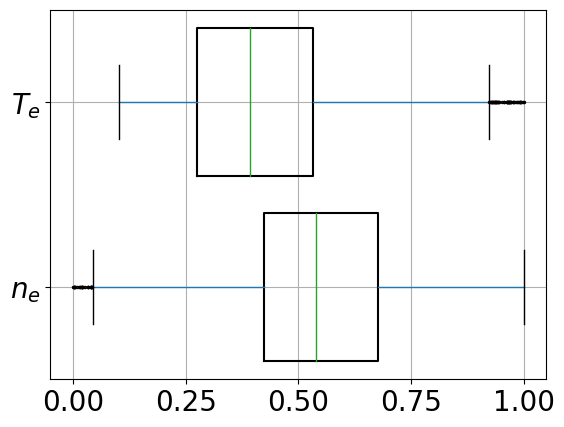

In [185]:
#concat y_train test val to new df
y_all = pd.concat([y_train, y_test, y_val], sort=False, axis = 0)

plot = y_all.boxplot(column=['ne', 'Te'], vert=False, flierprops=flierprops, boxprops=boxprops, widths=0.8)
# increase lable size
plt.rc('xtick', labelsize=20)
plt.rc('ytick', labelsize=20)
# change lables on y axis
plt.yticks([1, 2], ['$n_e$', '$T_e$'])


In [186]:
# transform all tp numpy arrays
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
X_train = X_train.to_numpy()
X_test = X_test.to_numpy()
X_val = X_val.to_numpy()
y_val = y_val.to_numpy()
# Get the number of inputs and outputs to enter into the network


In [187]:
n_inputs= int(np.shape(X_train)[1])
n_outputs = int(np.shape(y_train)[1])

# The Network

In [188]:
loss = 'mse'

def get_model(n_inputs, n_outputs):
    
    model = Sequential()
    model.add(layers.Dense(n_inputs, input_dim=n_inputs,  activation='tanh'))
    model.add(layers.Dense(units=210, activation="relu"))  
    model.add(layers.Dense(units=460, activation="relu"))  
    model.add(layers.Dense(units=260, activation="relu"))  
    model.add(layers.Dense(units=260, activation="relu"))  
    # add dropout layer to prevent overfitting
    model.add(layers.Dropout(0.2))
    model.add(Dense(n_outputs, activation='relu'))
    # Compile the model with mean squared error loss
    model.compile(loss = loss, optimizer='adam' , metrics=['mean_squared_error', 'mean_absolute_error', RSquare()])#, r2_score ]) #, mean_absolute_percentage_error])
    # TRY WITH MSE AS LOSS FUNCTION --> BETTER FOR IGNORING OUTLIERS
    return model

In [189]:
model = get_model(n_inputs, n_outputs)
model.build(input_shape=(None, n_inputs))
print('Model summary:')
print(model.summary()) # print summary of the NN shape
# fit the model on all data
# Fit the model on the training data

Model summary:
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 9)                 90        
                                                                 
 dense_13 (Dense)            (None, 210)               2100      
                                                                 
 dense_14 (Dense)            (None, 460)               97060     
                                                                 
 dense_15 (Dense)            (None, 260)               119860    
                                                                 
 dense_16 (Dense)            (None, 260)               67860     
                                                                 
 dropout_2 (Dropout)         (None, 260)               0         
                                                                 
 dense_17 (Dense)            (None, 2) 

In [190]:
retrain = True

In [191]:
if retrain == True:
    print('Fitting data to model for model training')
    start_time = datetime.now()
    # GET DATE
    today = datetime.now().strftime("%Y-%m-%d")
    checkpoint_filepath = 'models/' + str(today) + '_model.h5'
    earlystopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)
    # save model to file to only save the best mode
    model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_filepath,
        save_weights_only=True,
        monitor='val_loss',
        mode='min',
        save_best_only=True)
    # fit the model using early stopping and validation data, use callbacks to save the best model and saev the model
    history = model.fit(X_train, y_train, epochs=500, batch_size=50, validation_data=(X_val, y_val), callbacks=[earlystopping,model_checkpoint_callback]) #, ModelCheckpoint(filepath=model_name, save_best_only=True, monitor='val_loss', mode='min')])


    print('model trained')

    end_time = datetime.now() 
    #print('Duration of Training: {}'.format(end_time - start_time))
    print('------------------------------------')
    # The model weights (that are considered the best) are loaded into the
    # model.
else:
    print('Loading weights from previous model')
    checkpoint_filepath = 'models/2023-05-11_model.h5'
    model.load_weights(checkpoint_filepath)
    print('Weights loaded')
    print('------------------------------------')


Fitting data to model for model training
Epoch 1/500


121/121 [==============================] - 1s 3ms/step - loss: 0.0421 - mean_squared_error: 0.0421 - mean_absolute_error: 0.1440 - r_square: -0.3537 - val_loss: 0.0138 - val_mean_squared_error: 0.0138 - val_mean_absolute_error: 0.0845 - val_r_square: 0.5653
Epoch 2/500
121/121 [==============================] - 0s 2ms/step - loss: 0.0132 - mean_squared_error: 0.0132 - mean_absolute_error: 0.0866 - r_square: 0.5803 - val_loss: 0.0096 - val_mean_squared_error: 0.0096 - val_mean_absolute_error: 0.0713 - val_r_square: 0.6927
Epoch 3/500
121/121 [==============================] - 0s 3ms/step - loss: 0.0107 - mean_squared_error: 0.0107 - mean_absolute_error: 0.0769 - r_square: 0.6598 - val_loss: 0.0079 - val_mean_squared_error: 0.0079 - val_mean_absolute_error: 0.0617 - val_r_square: 0.7466
Epoch 4/500
121/121 [==============================] - 0s 3ms/step - loss: 0.0095 - mean_squared_error: 0.0095 - mean_absolute_error: 0.0724 - r_square: 0.6976 - val_loss: 0.0070 - val_mean_squared_error:

In [192]:
#PREDICT VALUES and show results
s = 'Metrics for training data: \n'
print(s)
predictions_train = model.predict(X_train, verbose=0)

# Calculate the MSE of the predictions_train
mse = mean_squared_error(y_train, predictions_train)

mae = mean_absolute_error(y_train, predictions_train)

# calculate accuracy of TRAIN predictions
r2 = r2_score(y_train, predictions_train) 

#calculate accuracy of predictions 
accuracy = 1 - (mse/np.var(y_train))  # variance of true values 

  
#print accuracy of predictions  
#print("Accuracy of predictions:", accuracy)
#print r2 score
print("R2 score:", r2)
# Print the MSE
print("MSE: %.5f" % mse)
print("MAE: %.5f" % mae)
# plot predictions against true values
pred_train = pd.DataFrame(predictions_train, columns=['ne_pre','Te_pre'])

#s += 'Accuracy of predictions: %.5f \n' % accuracy
s += 'R2 score: %.5f \n' % r2
s += 'MSE: %.5f \n' % mse 
s += 'MAE: %.5f \n' % mae
mae_t = mae
s += '------------------------------------ \n'
print("-------------------------")

print('Metrics for test data:')
#start timer 
start_time = datetime.now()
predictions_test = model.predict(X_test, verbose=0)
# stop timer
end_time = datetime.now()
print('Duration of Prediction: {}'.format(end_time - start_time))
# calculate accuracy of predictions for continuous data
r2 = r2_score(y_test, predictions_test) 
#calculate accuracy of predictions 
accuracy = 1 - (mse/np.var(y_test))  # variance of true values 
  
#print accuracy of predictions  
#print("Accuracy of predictions:", accuracy)
#print r2 score
print("R2 score:", r2)

# Calculate the MSE of the predictions_test
mse = mean_squared_error(y_test, predictions_test)
mae = mean_absolute_error(y_test, predictions_test)

# Print the MSE
print("MSE: %.5f" % mse)
print("MAE: %.5f" % mae)
# plot predictions against true values
pred_test = pd.DataFrame(predictions_test, columns=['ne_pre','Te_pre'])

s += 'Metrics for test data data: \n'
#s += 'Accuracy of predictions: %.5f \n' % accuracy
s += 'R2 score: %.5f \n' % r2
s += 'MSE: %.5f \n' % mse 
s += 'MAE: %.5f \n' % mae

mae_v = mae

Metrics for training data: 

R2 score: 0.9739526471035777
MSE: 0.00081
MAE: 0.01976
-------------------------
Metrics for test data:
Duration of Prediction: 0:00:00.049571
R2 score: 0.9463489024573561
MSE: 0.00160
MAE: 0.02628


## RESULTS FROM TRAINING

In [122]:
pred_out1, target_out1 = predictionStats(pred_test, y_test, TeMax)

R2 score: 0.9460808445366511
MSE: 0.00161
MAE: 0.02663
MAPE: 0.07758


IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

<Figure size 200x200 with 0 Axes>

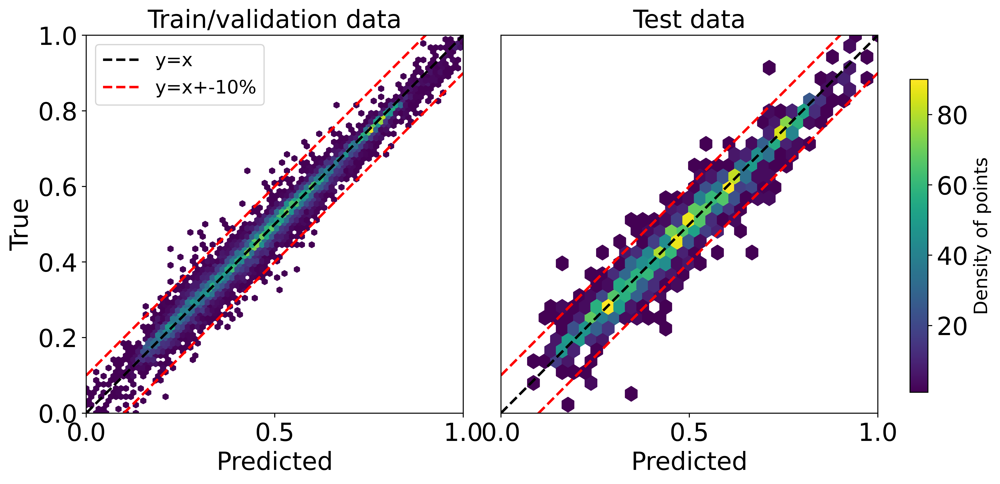

In [123]:
fig, ax = plt.subplots(1,2,figsize=(10, 5), dpi=500)
fig.tight_layout()
# add subplot title
ax[0].set_title('Train/validation data', fontsize=20)
a = 0.3
#['#004191', '#00BEFF', '#323232']
# create a colour map from red to blue with no white
# improt LinearSegmentedColormap from matplotlib
from matplotlib.colors import LinearSegmentedColormap
cm_rb = LinearSegmentedColormap.from_list('rb',["#004191", "#FF0000"], N=1000, gamma=1)
cm_rb ='viridis'



plt.subplots_adjust(wspace=0.)
# append te and ne data to one array
x = np.append(pred_train['Te_pre'],pred_train['ne_pre'])    
y = np.append(y_train[:,1],y_train[:,0])
# create density 
hb = ax[0].hexbin(x, y, gridsize=80, cmap=cm_rb, mincnt=1) #, edgecolor = "white", linewidths = .5)
# Add a colorbar
#cbar = plt.colorbar()
#cbar.set_label('Density')

#ax[0].scatter(x,y, alpha=a)
#ax[0].scatter(pred_train['Te_pre'],y_train[:,1],label='Te', alpha=a, color='#004191')
#ax[0].scatter(pred_train['ne_pre'],y_train[:,0],label='ne', alpha=a, color='#00BEFF')
ax[0].set_xlabel('Predicted', fontsize=20)
ax[0].set_ylabel('True', fontsize=20)
#ax[0].legend(fontsize=15)

xval_exp = np.linspace(0, 1, 100)
ax[0].plot(xval_exp, xval_exp, ls="--", c='black', linewidth=2, label='y=x')
ax[1].plot(xval_exp, xval_exp, ls="--", c='black', linewidth=2)
#text = ("MAE: %.5f" % mae_t)
#ax[0].text(.6, .1, text, bbox=dict(facecolor= '#323232', alpha=a), fontsize=15)
# increse tick size
ax[0].tick_params(axis='both', which='major', labelsize=20)

# add another text box no colour
#ax[0].text(.7, .1, 'Train and Validation \n data', bbox=dict(facecolor='none', alpha=0.5))

# append te and ne data to one array
x = np.append(pred_test['Te_pre'],pred_test['ne_pre'])
y = np.append(y_test[:,1],y_test[:,0])
# create density
ax[1].hexbin(x, y, gridsize=30, cmap=cm_rb, mincnt=1)
# Add a colorbar

# plot predictions against true values
#ax[1].scatter(x,y, alpha=a)

ax[1].set_title('Test data', fontsize=20)
#ax[1].scatter(pred_test['Te_pre'],y_test[:,1],label='Te', alpha=a, color='#004191')
#ax[1].scatter(pred_test['ne_pre'],y_test[:,0],label='ne', alpha=a, color='#00BEFF')
ax[1].set_xlabel('Predicted', fontsize=20)
#ax[1].set_ylabel('True', fontsize=20)
# remove y ticks
ax[1].set_yticks([])
#set x ticks every 0.5
ax[1].set_xticks(np.arange(0, 1.1, 0.5))
ax[0].set_xticks(np.arange(0, 1.1, 0.5))
# Add a colorbar to the right side of plot 1
cbar_ax = fig.add_axes([0.99, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
cbar = fig.colorbar(hb, cax=cbar_ax)
cbar.set_label('Density of points', fontsize=15)


ax[1].tick_params(axis='both', which='major', labelsize=20)

# add +- 10% lines to the y=x line
ax[1].plot(xval_exp, xval_exp+0.1, ls="--", c='red', linewidth=2)
ax[1].plot(xval_exp, xval_exp-0.1, ls="--", c='red', linewidth=2)
ax[0].plot(xval_exp, xval_exp+0.1, ls="--", c='red', linewidth=2, label='y=x+-10%')
ax[0].plot(xval_exp, xval_exp-0.1, ls="--", c='red', linewidth=2)

# add cbar to right side of plot 1

#set ax limits 01 
ax[0].set_xlim(0,1)
ax[0].set_ylim(0,1)
ax[1].set_xlim(0,1)
ax[1].set_ylim(0,1)
# increase w space
plt.subplots_adjust(wspace=0.1)
# add legend
ax[0].legend(fontsize=15, loc='upper left')

# 
#save the figure as png
#fig.savefig('PDF_Reports/pred_vs_true.png', dpi=300)

In [124]:
# get percentage error on Te and ne predictions
Te_per_err = np.abs((y_test[:,1] - pred_test['Te_pre'])/y_test[:,1])*100
ne_per_err = np.abs((y_test[:,0] - pred_test['ne_pre'])/y_test[:,0])*100
#print the mean percentage error
print('Mean percentage error on Te predictions: %.2f' % np.mean(Te_per_err))
print('Mean percentage error on ne predictions: %.2f' % np.mean(ne_per_err))


Mean percentage error on Te predictions: 7.49
Mean percentage error on ne predictions: 8.02


In [125]:
# get the number of Te_per_err <10% and ne_per_err <10%
Te_10 = np.sum(Te_per_err < 10)/len(Te_per_err)*100
ne_10 = np.sum(ne_per_err < 10)/len(ne_per_err)*100
print('ne < 10%: ', ne_10)
print('Te < 10%: ', Te_10)

ne < 10%:  83.57615894039735
Te < 10%:  74.83443708609272


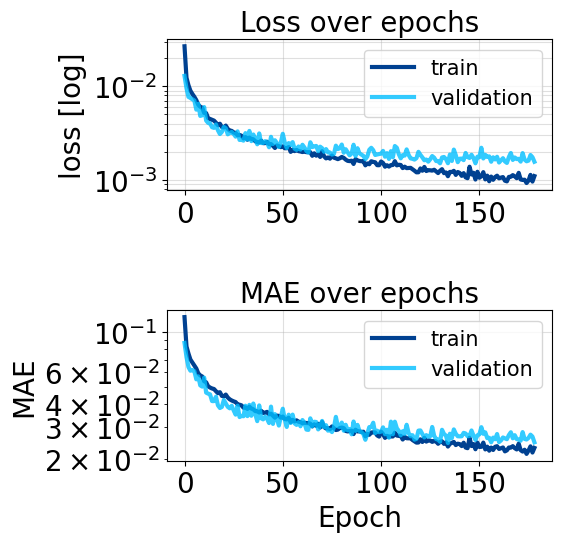

In [126]:

fig, axs = plt.subplots(2,figsize=(5, 5))#,dpi =300)
# add hspace
fig.tight_layout()
plt.subplots_adjust(hspace=0.8)
#adjust colour scheme

# add grid
axs[0].grid(alpha=0.4)

axs[1].grid(alpha=0.4)

axs[0].yaxis.set_major_formatter(ticker.ScalarFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_locator(ticker.LogLocator(subs=range(2, 10)))
axs[0].grid(which='both', alpha=0.4)
# add ticks to x grid lines too
axs[0].grid(which='minor', axis='x', linewidth=0.5)



# increase tick size
axs[0].tick_params(axis='both', which='major', labelsize=20)
axs[1].tick_params(axis='both', which='major', labelsize=20)

#increase the thickness of the line plots

lw =3

axs[0].set_title('Loss over epochs', fontsize=20)
axs[0].plot(history.history['loss'], label='train', color = '#004191',linewidth=lw)
axs[0].plot(history.history['val_loss'], label='validation', color = '#00BEFF', alpha =0.8, linewidth=lw)
axs[0].set_yscale('log')
axs[0].set_ylabel('loss [log]', fontsize=20)
axs[0].legend(fontsize=15)

axs[1].set_title('MAE over epochs', fontsize=20)
axs[1].plot(history.history['mean_absolute_error'], label='train', color = '#004191', linewidth=lw)
axs[1].plot(history.history['val_mean_absolute_error'], label='validation', color = '#00BEFF', alpha =0.8,linewidth=lw )
axs[1].set_xlabel('Epoch', fontsize=20)
axs[1].set_yscale('log')
axs[1].set_ylabel('MAE',fontsize=20)
axs[1].legend(fontsize=15)
#make png


In [127]:
# rename columns to match the original data
pred_test = pred_test.rename(columns={'ne_pre': 'ne', 'Te_pre': 'Te'})

loaded_scaler = joblib.load('ne_scaler.pkl')
pred_test[['ne']] = loaded_scaler.inverse_transform(pred_test[['ne']])


pred_test[['ne']] = 10**pred_test[['ne']]
pred_test[['Te']] = pred_test[['Te']]*TeMax

# give predictions the same index as the original data
pred_test.index = y_test_ind


In [128]:
test_position_pred = pd.concat([pos_test, pred_test], axis=1)
# add column called test_train to test_position_pred with the value 'test' for all rows
test_position_pred['test_train'] = 'test'

train_position_pred = pd.concat([pos_train, y_train_df], axis=1)
# add column called test_train to train_position_pred with the value 'train' for all rows
train_position_pred['test_train'] = 'train'

val_position_pred = pd.concat([pos_val, y_val_df], axis=1)
# add column called test_train to val_position_pred with the value 'val' for all rows
val_position_pred['test_train'] = 'val'

# concatenate the three dataframes
position_pred = pd.concat([train_position_pred, val_position_pred, test_position_pred], axis=0)

# scale the data back to original values by multiplying by neMax and TeMax
#position_pred[['ne']] = position_pred[['ne']] #*neMax
#position_pred[['Te']] = position_pred[['Te']] #*TeMax

# set test train and val to be categorical
position_pred['test_train'] = pd.Categorical(position_pred['test_train'], categories=['train', 'val', 'test'])




In [129]:
#PREDICT VALUES and show results

#display predicted values and original values in one df 
new_results = pd.concat([y_train_df, pred_test])
new_results = pd.concat([new_results, y_val_df])
new_results.sort_index(axis=0, inplace=True)

# scale the data back to original values by multiplying by neMax and TeMax
new_results[['ne']] = new_results[['ne']]*neMax
new_results[['Te']] = new_results[['Te']]*TeMax

In [130]:
# organise by index
position_pred.sort_index(axis=0, inplace=True)


In [131]:
'''
# plot position_pred ne vs R_0, plot ne values labed as 'train', 'val' and 'test' in different colors
shot_plot = [10273, 10287, 10260, 10310, 10310]
shot_index_ranges = []
j = 0
for j in range(0, 5):
    shot_index = all_data_gas[all_data_gas['shot'] == shot_plot[j]].index[:]
    # convert to list
    shot_index = shot_index.tolist()
    # append to list of lists
    shot_index_ranges.append(shot_index)


plot_ind = np.array(shot_index_ranges[0])#, np.arange(410,420), np.arange(420,430), np.arange(600,610)]
shot_ind = plot_ind[3] #[0], plot_ind[1][0], plot_ind[2][0], plot_ind[3][0]]

R = [0.04, 0.05,0.06,0.07,0.08,0.09,0.1,0.11,0.12,0.13]
alpha = 0.2

# set the colour palette of test train and val in spepcific colours
sns.set_palette(sns.color_palette(['#004191', '#00BEFF', '#323232']))

palette=dict(train="#004191", val="#323232", test="#00BEFF")
markers = dict(train="o", val="o", test="D")
edgecolors = dict(train="white", val="white", test="white")
size = 350


# iterate over all axis in plot
fs =30
j=0
k=0
i=0
for i in [0,1,2,3]:
    fig, axs = plt.subplots(2, figsize=(13, 14))#, dpi=500)
    #plt.subplots_adjust(top=1.5, bottom=0.01)
    plt.subplots_adjust(hspace=0)
    # plot ne
    axs[1].set_title(' [#' + str(int(all_data.iloc[shot_ind]['shot'])) + 
                        ', Gas: ' + str(all_data_gas.iloc[shot_ind]['gas']) + ']',
                         fontsize=fs+3, loc = 'left')
    axs[0].fill_between(all_data.iloc[plot_ind]['R_0'], all_data.iloc[plot_ind]['ne']*(1-0.1),
                        all_data.iloc[plot_ind]['ne']*(1+0.1), alpha=alpha, label='10% error',
                        color='#323232')
    axs[0].scatter(R, all_data.iloc[plot_ind]['ne'], label = 'Ground Truth', s=size-10, c='black', 
                   marker = 'H')

    # change the shape of markers for each set in test_train
    sns.scatterplot(ax=axs[0],x='R_0', y='ne', hue='test_train', style='test_train', data=position_pred.iloc[plot_ind],
                     palette=palette, markers=markers, s=size, edgecolor='white')

    
    axs[0].grid(True, alpha=0.4)
    axs[0].set_xlabel('')
    axs[0].set_ylabel('$n_e$ [m$^{-3}$]', fontsize=fs+3)
    # remove titile from legend

    # xticks
    
    axs[0].legend().set_visible(False)
    #increse x tics size
    #axs[0].tick_params(axis='x', labelsize=fs-2)
    #axs[0].tick_params(axis='y', labelsize=fs-2)
    #increse text size of scaling factor on y axis
    axs[0].yaxis.get_offset_text().set_fontsize(fs-5)
    axs[1].yaxis.get_offset_text().set_fontsize(fs-5)
    # get the ordder of magnitude of the y axis
    y_order = orderOfMagnitude( all_data.iloc[plot_ind]['ne'].max())
    

    #Te

    axs[1].fill_between(all_data.iloc[plot_ind]['R_0'], all_data.iloc[plot_ind]['Te']*(1-0.1),
                        all_data.iloc[plot_ind]['Te']*(1+0.1), alpha=alpha, label='10% error',
                        color='#323232')
    axs[1].scatter(R, all_data.iloc[plot_ind]['Te'], label = 'Ground Truth', s=size-10,
                   c='black', marker = 'H')

    sns.scatterplot(ax=axs[1],x='R_0', y='Te', hue='test_train', data=position_pred.iloc[plot_ind], style='test_train',
                     palette=palette, markers=markers, s=size, edgecolor='white')


    axs[1].grid(True, alpha=0.4)
    axs[1].set_xlabel('$R-R_0$ [m]', fontsize=fs+3)
    axs[1].set_ylabel('$T_e$ [eV]', fontsize=fs+3)

    # turn legend off
    axs[1].legend().set_visible(False)

    axs[0].set_xticks(R)
    axs[1].set_xticks(R)
    axs[0].tick_params(axis='x', labelsize=fs-1)
    axs[0].tick_params(axis='y', labelsize=fs-1)
    axs[1].tick_params(axis='x', labelsize=fs-1)
    axs[1].tick_params(axis='y', labelsize=fs-1)

    if i == 1:
        #handles, labels = axs[0].get_legend_handles_labels()
        #axs[0].legend(handles=handles[0:], markerscale=2, labels=labels[0:], loc='upper right', fontsize=fs-5)
        lgnd = axs[0].legend(loc="upper right", scatterpoints=1, fontsize=fs-3)
        lgnd.legendHandles[0]._sizes = [size+5]
        lgnd.legendHandles[1]._sizes = [size]
        lgnd.legendHandles[2]._sizes = [size]
        lgnd.legendHandles[3]._sizes = [size]
        lgnd.legendHandles[4]._sizes = [size]

    #increase x ticks size
    #axs[1].tick_params(axis='x', labelsize=fs-2)
    #axs[1].tick_params(axis='y', labelsize=fs-2)

    # set x ticks to be every 0.02 m
    axs[1].xaxis.set_major_locator(ticker.MultipleLocator(0.02))
    axs[0].xaxis.set_major_locator(ticker.MultipleLocator(0.02))

    # set only 3 ticks on y axis
    axs[1].yaxis.set_major_locator(ticker.MultipleLocator(int(2)))
    axs[0].yaxis.set_major_locator(ticker.MultipleLocator(.5*10**y_order))
    if y_order != 18:
        axs[0].yaxis.set_major_locator(ticker.MultipleLocator(1*10**y_order))
    # increase plot_ind by 10 
    k = k+1
    plot_ind = np.array(shot_index_ranges[k])
    shot_ind = plot_ind[0]
    plt.savefig('PDF_Reports\\predict_missing'+ str(i) + '.png',dpi=500, bbox_inches='tight')
    plt.close()
  
fig = plt.figure(figsize=(8, 9), dpi=500)
gs = gridspec.GridSpec(2, 2)
# tight layout
plt.tight_layout()
# remove the white space between subplots
gs.update(wspace=0.005, hspace=0.005)
# decrease horizontal space between subplots

ax1 = plt.subplot(gs[0, 0])
ax2 = plt.subplot(gs[0, 1])
ax3 = plt.subplot(gs[1, 0])
ax4 = plt.subplot(gs[1, 1])
ax1.imshow(plt.imread('PDF_Reports\\predict_missing0.png'))
ax2.imshow(plt.imread('PDF_Reports\\predict_missing1.png'))
ax3.imshow(plt.imread('PDF_Reports\\predict_missing2.png'))
ax4.imshow(plt.imread('PDF_Reports\\predict_missing3.png'))
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')


plt.savefig('PDF_Reports\\ne_Te_R0.png', bbox_inches='tight') #,dpi=300
plt.show()
'''

'\n# plot position_pred ne vs R_0, plot ne values labed as \'train\', \'val\' and \'test\' in different colors\nshot_plot = [10273, 10287, 10260, 10310, 10310]\nshot_index_ranges = []\nj = 0\nfor j in range(0, 5):\n    shot_index = all_data_gas[all_data_gas[\'shot\'] == shot_plot[j]].index[:]\n    # convert to list\n    shot_index = shot_index.tolist()\n    # append to list of lists\n    shot_index_ranges.append(shot_index)\n\n\nplot_ind = np.array(shot_index_ranges[0])#, np.arange(410,420), np.arange(420,430), np.arange(600,610)]\nshot_ind = plot_ind[3] #[0], plot_ind[1][0], plot_ind[2][0], plot_ind[3][0]]\n\nR = [0.04, 0.05,0.06,0.07,0.08,0.09,0.1,0.11,0.12,0.13]\nalpha = 0.2\n\n# set the colour palette of test train and val in spepcific colours\nsns.set_palette(sns.color_palette([\'#004191\', \'#00BEFF\', \'#323232\']))\n\npalette=dict(train="#004191", val="#323232", test="#00BEFF")\nmarkers = dict(train="o", val="o", test="D")\nedgecolors = dict(train="white", val="white", test="wh

In [132]:
def get_model_summary(model):
    stream = io.StringIO()
    model.summary(print_fn=lambda x: stream.write(x + '\n'))
    summary_string = stream.getvalue()
    stream.close()
    return summary_string
    
model_str = get_model_summary(model)
# make subplot of images stored in PDF_Reports 
plot_model(model, to_file='PDF_Reports/model.png', show_shapes=True, show_layer_names=True, expand_nested=True, dpi=300, show_layer_activations=True)
#dont show the plot
plt.close()

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [133]:
'''
fig = plt.figure(figsize=(8.5, 11))
rows = 6
cols = 2

# ask user to input comments in pop up window push enter to save
comments = input('Enter comments: ')
# save comment as string
comments = str(comments)

grid = plt.GridSpec(rows, cols)#, wspace=0.01, hspace=0.1)
plt.subplots_adjust(top=1.5, bottom=0.01, left=0.01, right=0.99, hspace=0.1, wspace=0.1)
# add txt to grid[0, 0]
fig_ax6= fig.add_subplot(grid[0, 0])
# add date and time to txt
fig_ax6.text(0.1, 0.9, 'Report:' + dt_format, fontsize=12, fontweight='bold', va='top')
fig_ax6.text(0.1, 0.8, 'Comments:' + comments, fontsize=12, fontweight='bold', va='top')
fig_ax6.text(0.1, 0.7, 'Duration of Training: {}'.format(end_time - start_time) + ' [HH:MM:SS:ms]', fontsize=12, fontweight='bold', va='top')
fig_ax6.set_axis_off()

fig_ax0= fig.add_subplot(grid[1, 0])
fig_ax0.imshow(plt.imread('PDF_Reports\\model.png'))
# add comment to plot
fig_ax0.text(0, 1, 'Loss: ' + loss, fontsize=12, va='top')
fig_ax0.set_axis_off()

# add txt to grid[0, 1]
fig_ax0= fig.add_subplot(grid[1, 1])
fig_ax0.text(0.1, 0.9, s, fontsize=12, va='top')
fig_ax0.set_axis_off()

#add png to figure IV_normalisation.png
# increse size of figure
fig_ax1 = fig.add_subplot(grid[2, 0])
fig_ax1.imshow(plt.imread('PDF_Reports\\IV_normalisation.png'))
fig_ax1.set_axis_off()
fig_ax2 = fig.add_subplot(grid[2, 1])
fig_ax2.imshow(plt.imread('PDF_Reports\\Te_ne_raw.png'))
fig_ax2.set_axis_off()
fig_ax3 = fig.add_subplot(grid[3, 0])
fig_ax3.imshow(plt.imread('PDF_Reports\\pred_vs_true.png'))
fig_ax3.set_axis_off()
fig_ax4 = fig.add_subplot(grid[3, 1])
fig_ax4.imshow(plt.imread('PDF_Reports\\loss_accuracy.png'))
fig_ax4.set_axis_off()
fig_ax5 = fig.add_subplot(grid[4:6, :2])
fig_ax5.imshow(plt.imread('PDF_Reports\\ne_Te_R0.png'))
fig_ax5.set_axis_off()
plt.close()
# save fig as pdf
if comments != '':
    fig.savefig('PDF_Reports\\' + dt_string + '.pdf', dpi=300, bbox_inches='tight')
    '''

"\nfig = plt.figure(figsize=(8.5, 11))\nrows = 6\ncols = 2\n\n# ask user to input comments in pop up window push enter to save\ncomments = input('Enter comments: ')\n# save comment as string\ncomments = str(comments)\n\ngrid = plt.GridSpec(rows, cols)#, wspace=0.01, hspace=0.1)\nplt.subplots_adjust(top=1.5, bottom=0.01, left=0.01, right=0.99, hspace=0.1, wspace=0.1)\n# add txt to grid[0, 0]\nfig_ax6= fig.add_subplot(grid[0, 0])\n# add date and time to txt\nfig_ax6.text(0.1, 0.9, 'Report:' + dt_format, fontsize=12, fontweight='bold', va='top')\nfig_ax6.text(0.1, 0.8, 'Comments:' + comments, fontsize=12, fontweight='bold', va='top')\nfig_ax6.text(0.1, 0.7, 'Duration of Training: {}'.format(end_time - start_time) + ' [HH:MM:SS:ms]', fontsize=12, fontweight='bold', va='top')\nfig_ax6.set_axis_off()\n\nfig_ax0= fig.add_subplot(grid[1, 0])\nfig_ax0.imshow(plt.imread('PDF_Reports\\model.png'))\n# add comment to plot\nfig_ax0.text(0, 1, 'Loss: ' + loss, fontsize=12, va='top')\nfig_ax0.set_axis

## Test on 2D profiles

In [134]:
IV_2D =  pd.read_csv('IV_2D.csv', header=0)
all_data_2D = pd.read_csv('all_data_2D_edits.csv', header=0)
all_data_2D = all_data_2D.drop(all_data_2D.columns[0], axis=1)
IV_2D = IV_2D.drop(IV_2D.columns[0], axis=1)
# make gas coloum = all 1
all_data_2D['gas'] = 1
#remove R_0 from IV_2D
IV_2D = IV_2D.drop(['R_0'], axis=1)

In [135]:
#IV_2D, all_data_2D = removeOutliers(IV_2D, all_data_2D, True, False) # hard limits and IQR data removal set to false
# remove shots with the index max_der_index from flat IVS

#IV_2D,all_data_2D,filtered_dr,filteredI = IV_filter(IV_2D,all_data_2D)

In [136]:
# GIVE iv_2D ['gas', 'R_0', 'ID', 'shot'] FROM all_data_2D
start_time = datetime.now()
# add shot, ID gas R_0 to IV_Test_X from all_data_test
ID = all_data_2D[['shot', 'ID', 'gas', 'R_0']].copy()
# concat ID to IV_Test_X
IV_2D = pd.concat([IV_2D, ID], axis=1)

X_2D, y_2D = testPreprocessing(IV_2D, all_data_2D, VMax, IMax, neMax, TeMax, gasMax, pca)

pred_2D = model.predict(X_2D, verbose=0)
# end timer
end_time = datetime.now()
print('Duration of Prediction: {}'.format(end_time - start_time) + ' [HH:MM:SS:ms]')


X_test shape PRE PCA =  (441, 200)
           I0        I1        I2        I3        I4        I5        I6  \
0   -0.012498 -0.012454 -0.012113 -0.011917 -0.011668 -0.011567 -0.011437   
1   -0.013694 -0.013516 -0.013279 -0.013134 -0.012710 -0.012489 -0.012221   
2   -0.014007 -0.013893 -0.013592 -0.013431 -0.013314 -0.012969 -0.012916   
3   -0.014273 -0.013732 -0.013459 -0.013175 -0.012587 -0.012274 -0.011917   
4   -0.014798 -0.014491 -0.014298 -0.014001 -0.013653 -0.013529 -0.013134   
..        ...       ...       ...       ...       ...       ...       ...   
436 -0.012221 -0.012069 -0.011943 -0.011646 -0.011459 -0.011380 -0.011213   
437 -0.011721 -0.011557 -0.011409 -0.011175 -0.010771 -0.010676 -0.010404   
438 -0.011447 -0.011219 -0.010948 -0.010727 -0.010505 -0.010234 -0.009953   
439 -0.010660 -0.010351 -0.010199 -0.009968 -0.009732 -0.009599 -0.009416   
440 -0.010032 -0.010003 -0.009867 -0.009728 -0.009760 -0.009687 -0.009394   

           I7        I8        I9  ...  

C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\1467905228.py:110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gas[['gas']] = gas[['gas']]/gasMax


R2 score: 0.44797830057048843
MSE: 0.01598
MAE: 0.09150
MAPE: 0.24366
Mean percentage error on Te predictions: 21.81
Mean percentage error on ne predictions: 26.93
132
Percentage of ne predictions within 10% of true value:29.931972789115648
Percentage of Te predictions within 10% of true value:33.33333333333333


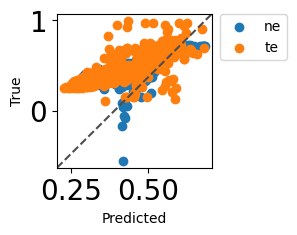

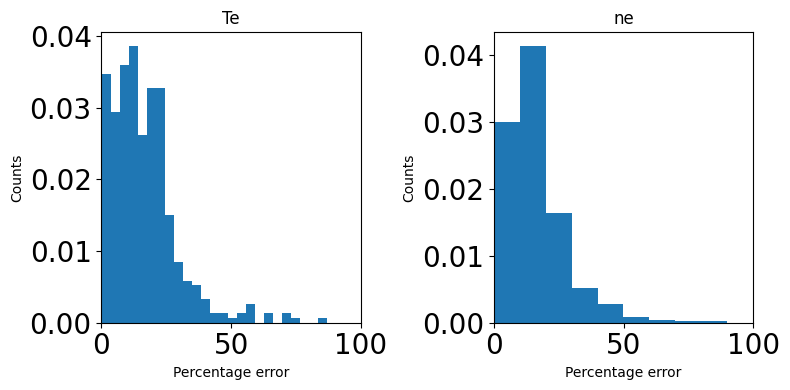

C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\2351091546.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  IV_Test_y[['ne']] = loaded_scaler.inverse_transform(IV_Test_y[['ne']])
C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\2351091546.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  IV_Test_y['ne'] = 10**IV_Test_y['ne']
C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\2351091546.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

In [137]:
pred_2D, y_2D = predictionStats(pred_2D, y_2D, TeMax)

In [138]:

all_data_2D['ne'] = y_2D['ne']
all_data_2D['Te'] = y_2D['Te']

In [139]:
pred_2D['R_0'] = all_data_2D['R_0']
pred_2D['z'] = all_data_2D['z']

In [140]:
#save pred_2D to csv
pred_2D.to_csv('pred_2D_6.csv', index=False)

<Axes: xlabel='R_0', ylabel='z'>

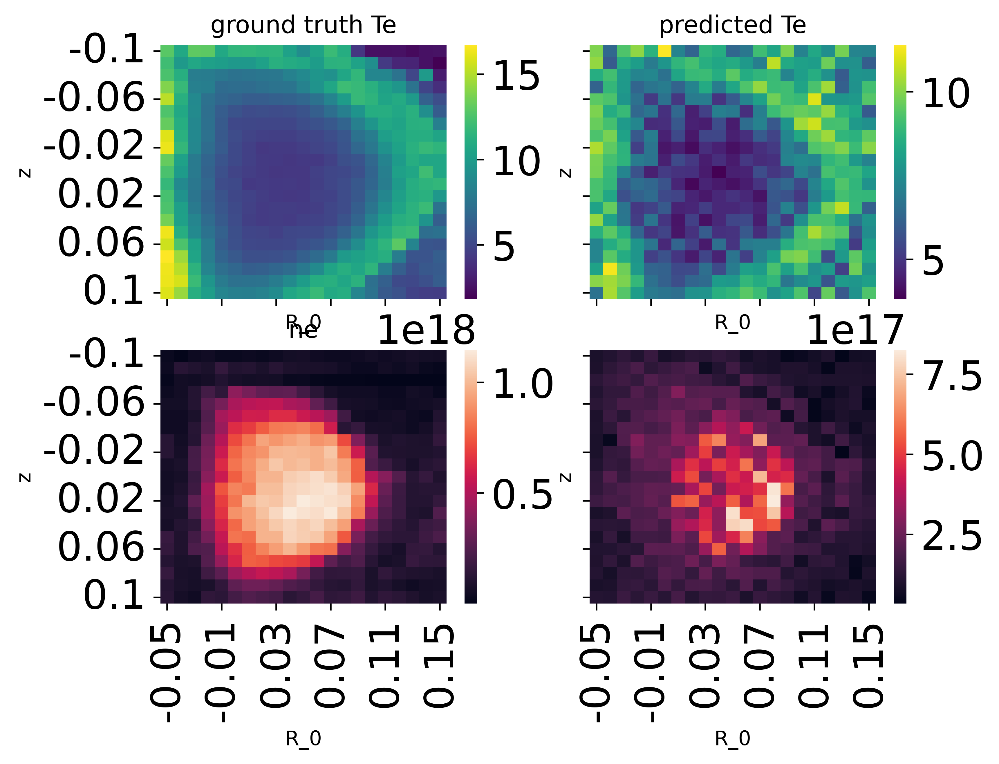

In [142]:
cmap2 = 'viridis'   # Use sns heatmap to plot Te as a function of R_0 and z
fig, axs = plt.subplots(2, 2, figsize=(7, 5), dpi =500, sharex=True, sharey=True)
sns.heatmap(all_data_2D.pivot_table(index='z', columns='R_0', values='Te'), cmap=cmap2,ax=axs[0, 0])
axs[0,0].set_title('ground truth Te')
sns.heatmap(all_data_2D.pivot_table(index='z', columns='R_0', values='ne'),  ax=axs[1, 0])
axs[1,0].set_title('ne')

sns.heatmap(pred_2D.pivot_table(index='z', columns='R_0', values='Te_pre'), cmap=cmap2, ax=axs[0, 1])
axs[0,1].set_title('predicted Te')
sns.heatmap(pred_2D.pivot_table(index='z', columns='R_0', values='ne_pre'),  ax=axs[1, 1])

#only display evert 2nd tick

## test of full unseen shots

In [143]:
# start timer
start_time = datetime.now()
# add shot, ID gas R_0 to IV_Test_X from all_data_test
ID = all_data_test[['shot', 'ID', 'gas', 'R_0']].copy()
# concat ID to IV_Test_X
IV_Test_X = pd.concat([IV_Test_X, ID], axis=1)
IV_Test_X, IV_Test_y = testPreprocessing(IV_Test_X, IV_Test_y, VMax, IMax, neMax, TeMax, gasMax, pca)



X_test shape PRE PCA =  (729, 200)
           I0        I1        I2        I3        I4        I5        I6  \
0   -0.052349 -0.052063 -0.051757 -0.050972 -0.050457 -0.050238 -0.049522   
1   -0.051995 -0.051660 -0.051124 -0.050726 -0.049989 -0.049002 -0.048614   
2   -0.049555 -0.048998 -0.048495 -0.047452 -0.047144 -0.046552 -0.045885   
3   -0.044272 -0.044351 -0.043446 -0.043127 -0.042431 -0.042277 -0.042024   
4   -0.038169 -0.037322 -0.036930 -0.036047 -0.035715 -0.035057 -0.034954   
..        ...       ...       ...       ...       ...       ...       ...   
724 -0.017092 -0.017145 -0.017084 -0.017048 -0.017056 -0.016791 -0.016558   
725 -0.015035 -0.014948 -0.014896 -0.014547 -0.014478 -0.014428 -0.014113   
726 -0.013312 -0.013031 -0.012903 -0.012916 -0.012822 -0.012601 -0.012485   
727 -0.011381 -0.011222 -0.011267 -0.010967 -0.010831 -0.010668 -0.010455   
728 -0.009898 -0.009814 -0.009715 -0.009620 -0.009411 -0.009187 -0.009148   

           I7        I8        I9  ...  

C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\1467905228.py:110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gas[['gas']] = gas[['gas']]/gasMax


Duration of Prediction: 0:00:00.071433 [HH:MM:SS:ms]
R2 score: 0.547420033079193
MSE: 0.05370
MAE: 0.08630
MAPE: 0.17640
Mean percentage error on Te predictions: 13.11
Mean percentage error on ne predictions: 22.17
494
Percentage of ne predictions within 10% of true value:67.76406035665295
Percentage of Te predictions within 10% of true value:62.41426611796982


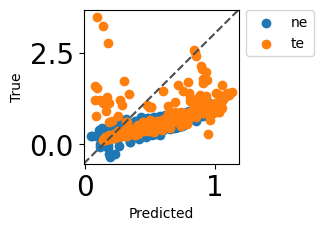

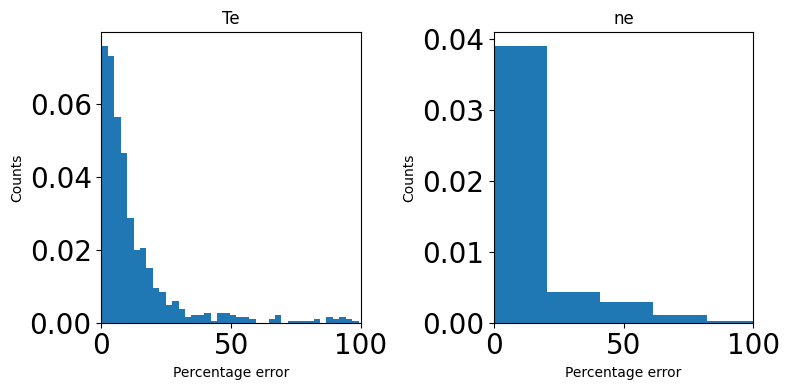

In [144]:
# SHOT ANALYSIS

pred_full = model.predict(IV_Test_X, verbose=0)
# end timer
end_time = datetime.now()
print('Duration of Prediction: {}'.format(end_time - start_time) + ' [HH:MM:SS:ms]')
pred_full, IV_Test_y = predictionStats(pred_full, IV_Test_y, TeMax)

## SHOT PREDICTION SCORES

shot:  10261.0 ne_err:  11.88922009936947 Te_err:  9.38701872690962
shot:  10262.0 ne_err:  14.099983004694064 Te_err:  9.252716257563254
shot:  13283.0 ne_err:  1.3774123729613235 Te_err:  4.614468128696154
shot:  13287.0 ne_err:  1.5622158253271279 Te_err:  5.271346689229551
shot:  10289.0 ne_err:  5.129553246595483 Te_err:  8.564320288909125
shot:  13082.0 ne_err:  23.30120561100772 Te_err:  9.344558415518426
shot:  2816.0 ne_err:  28.64900778362215 Te_err:  7.838213274464904
shot:  13260.0 ne_err:  1.6971891409787971 Te_err:  5.124481717497742
shot:  13220.0 ne_err:  8.978909188591865 Te_err:  9.159680148086576
shot:  13225.0 ne_err:  1.7143002024655594 Te_err:  6.523754954362336
shot:  11180.0 ne_err:  5.811127519650721 Te_err:  13.022264462430098
shot:  2812.0 ne_err:  11.473858463141882 Te_err:  13.538556647726047
shot:  13101.0 ne_err:  8.90307085705566 Te_err:  6.7408315551053235
shot:  13102.0 ne_err:  13.158010664654247 Te_err:  21.03417344132986
shot:  13103.0 ne_err:  19.8

C:\Users\ikejjosh\AppData\Local\Temp\ipykernel_13440\3260157468.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(2, 1, figsize=(7, 5), dpi =500)


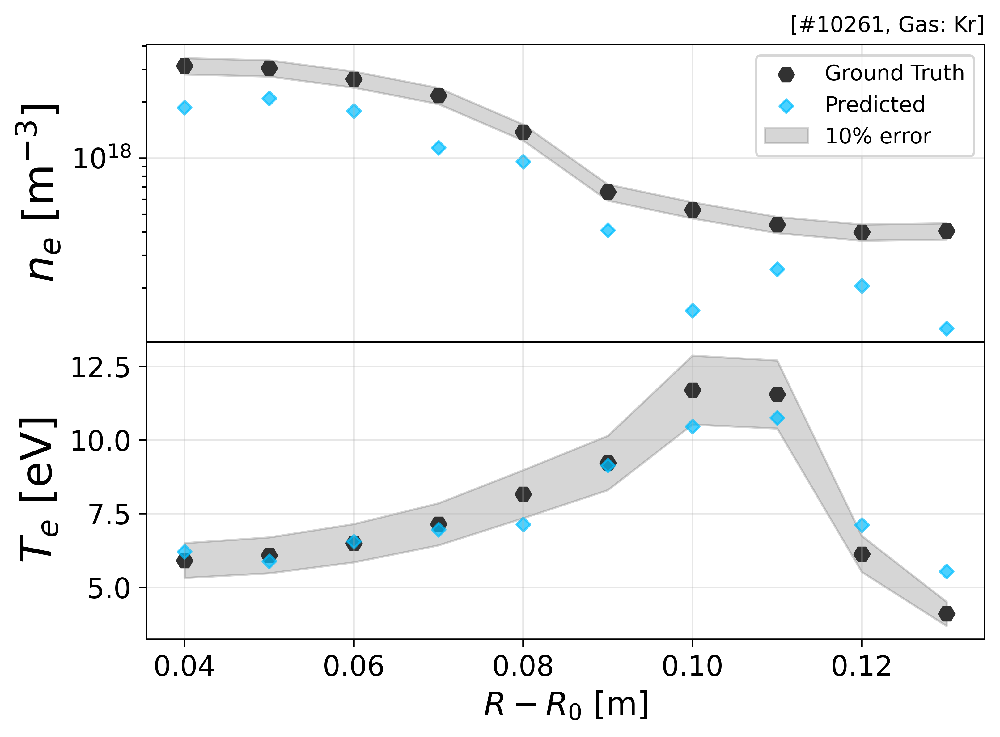

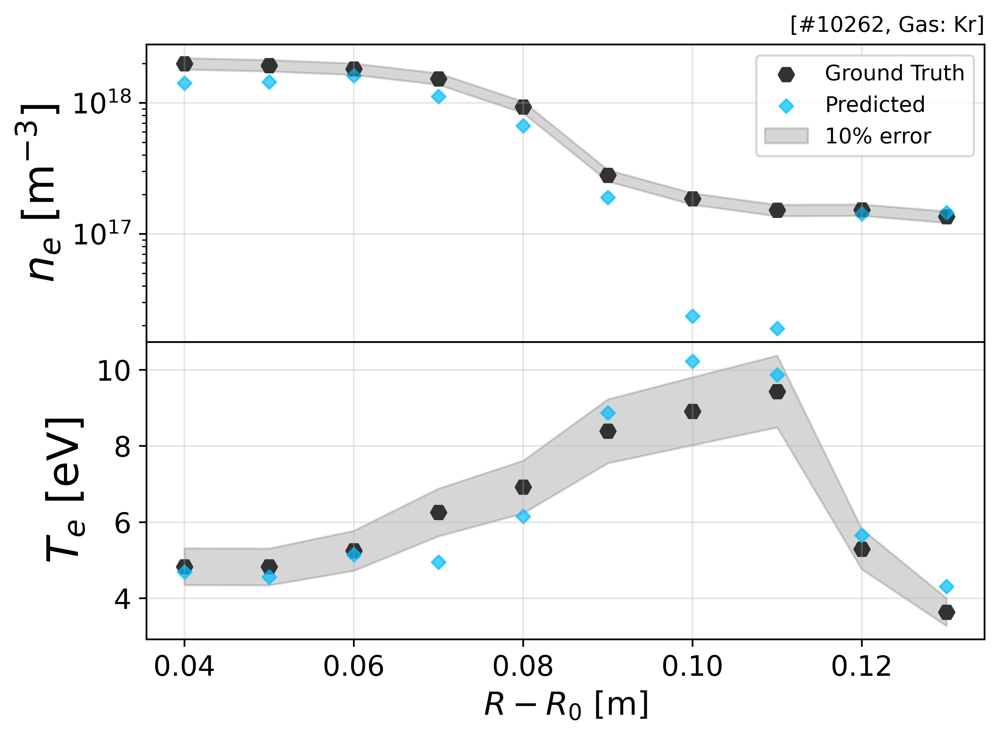

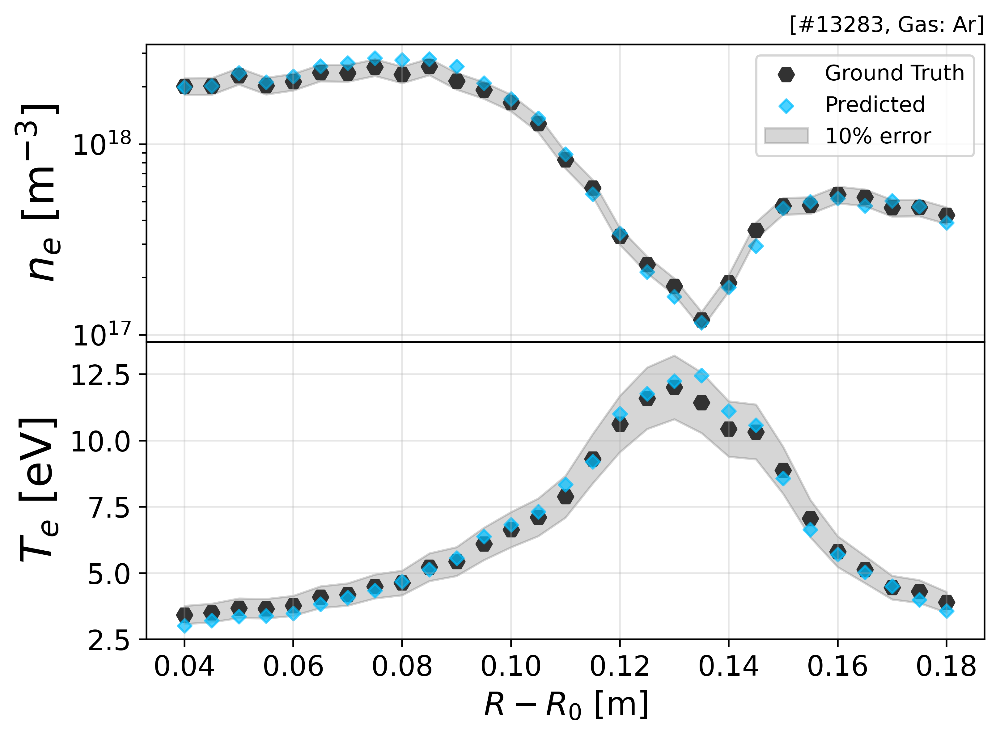

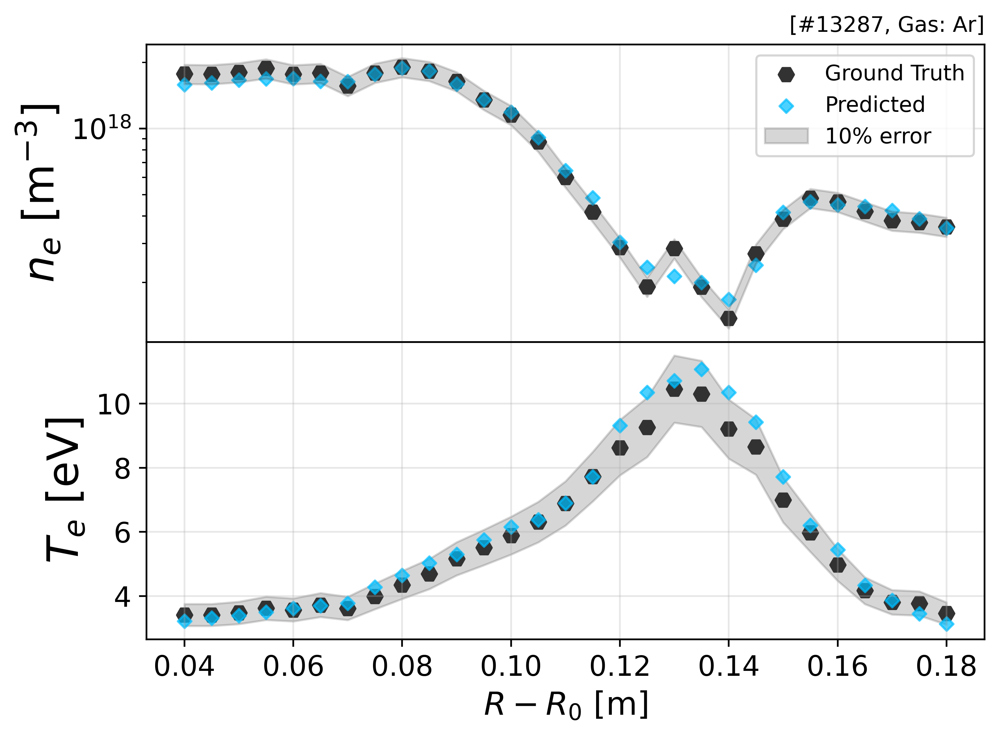

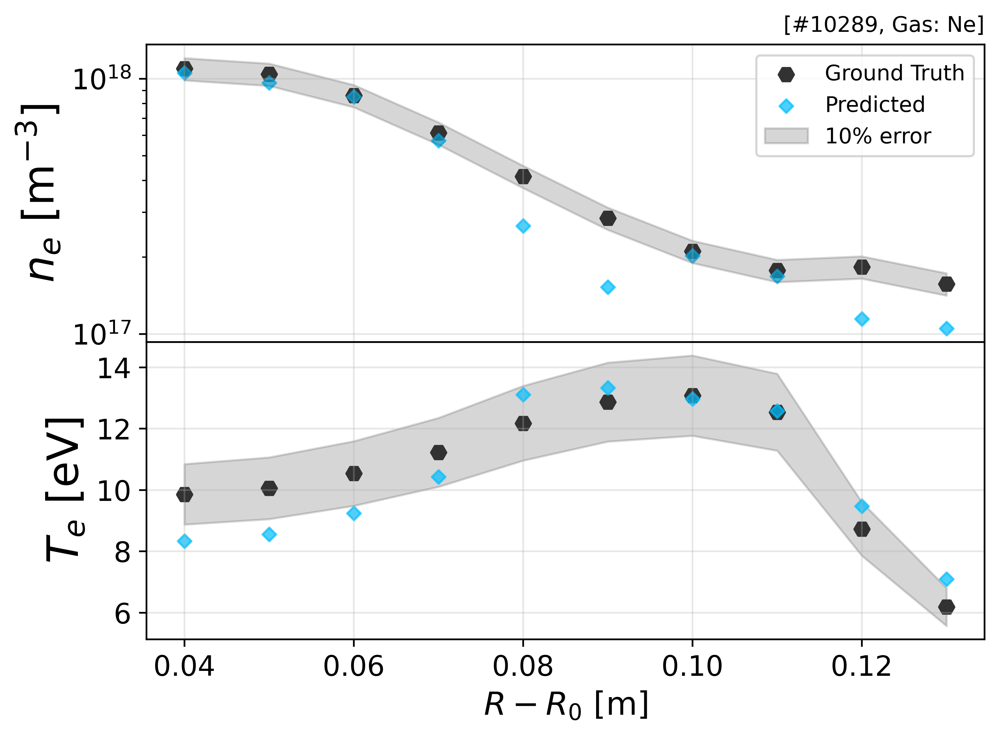

...

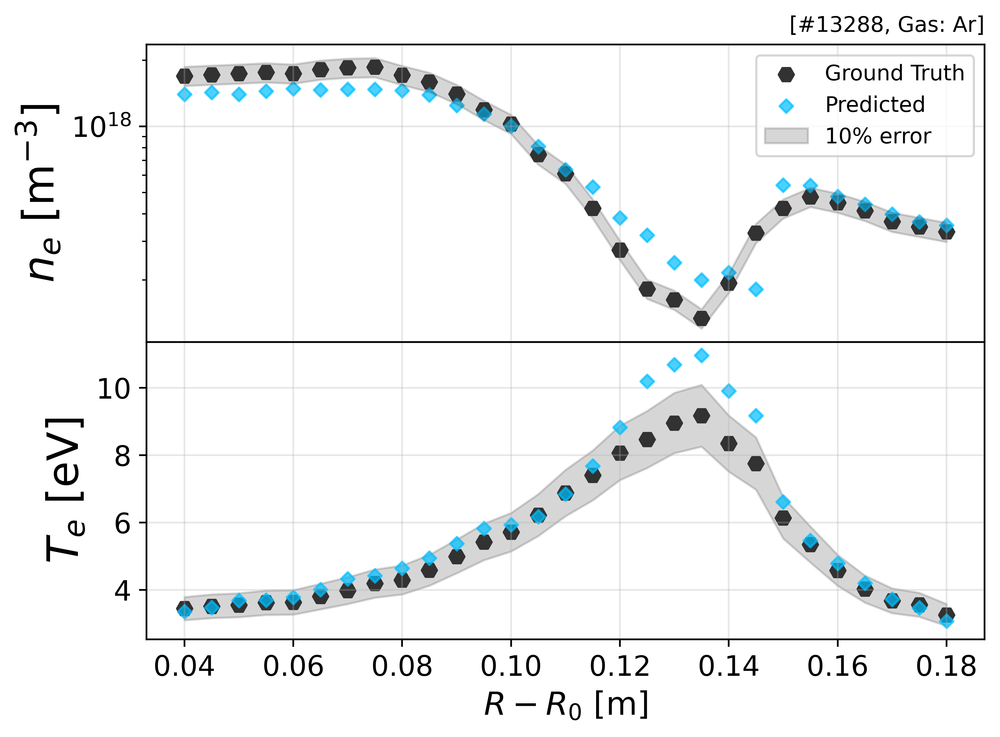

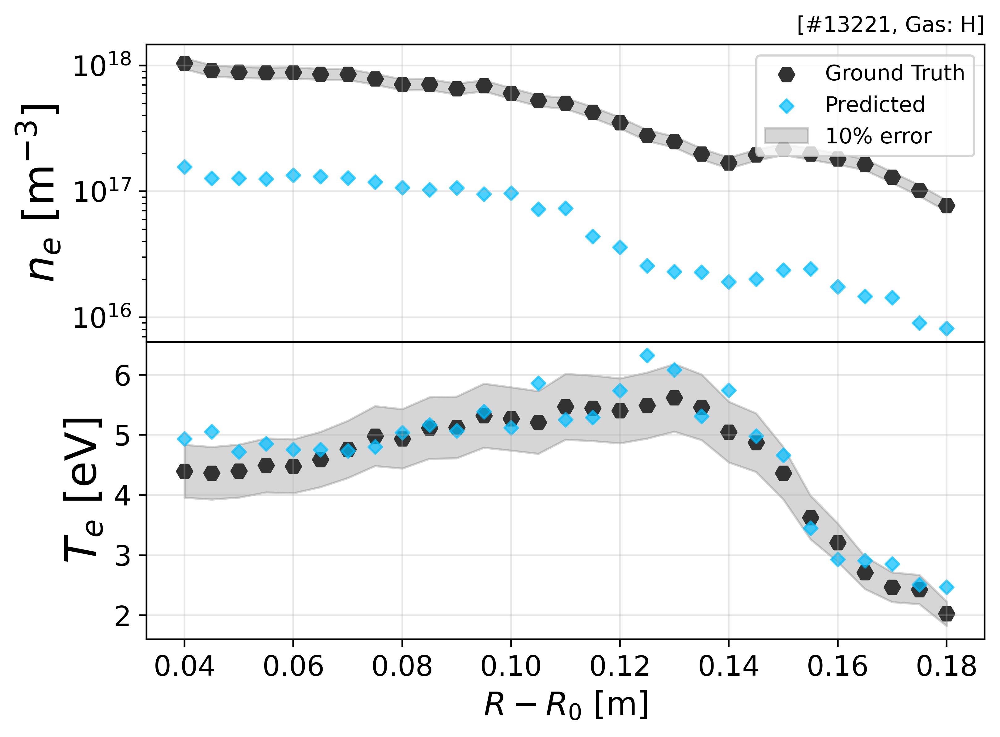

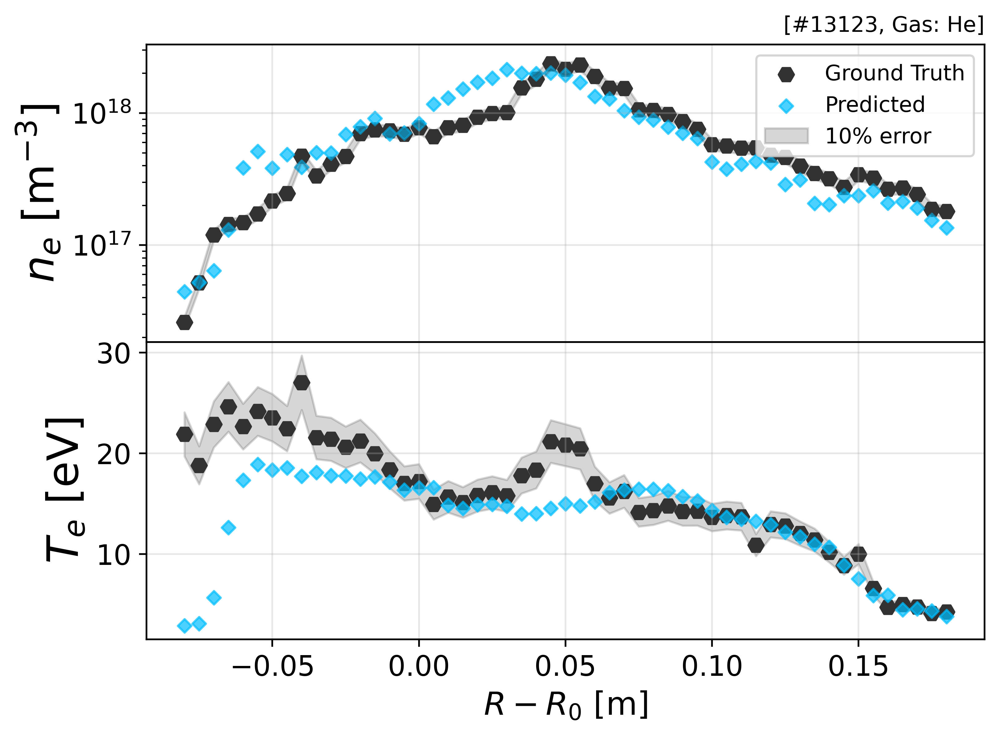

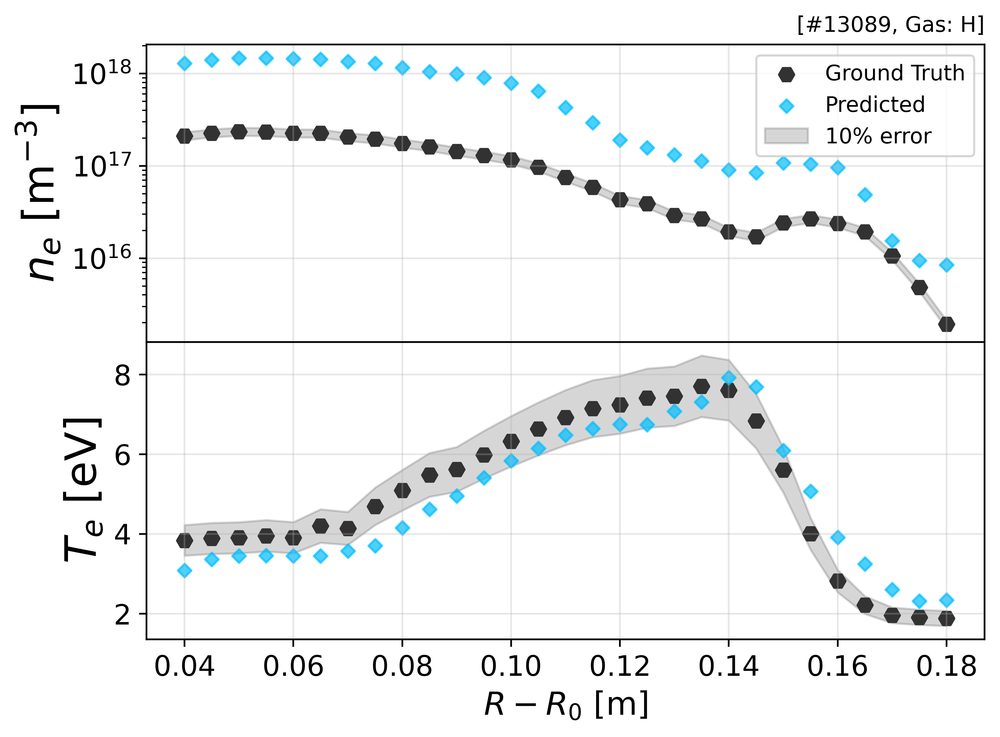

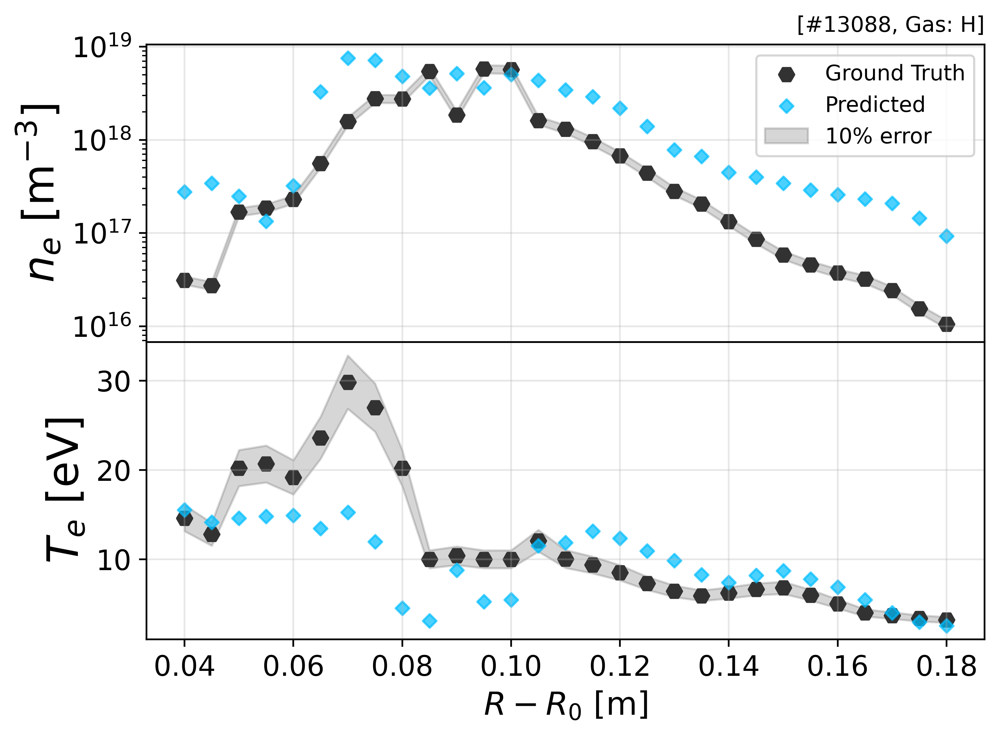

In [146]:
# plot ne vs r0

# append shot number to IV_Test_y and pred_full from all_data_test
# reset index 
#IV_Test_y = IV_Test_y.reset_index(drop=True)
#pred_full = pred_full.reset_index(drop=True)
#all_data_test = all_data_test.reset_index(drop=True)
IV_Test_y['shot'] = all_data_test['shot']
pred_full['shot'] = all_data_test['shot']
IV_Test_X['shot'] = all_data_test['shot']
alphapred = 0.7
sizepred = 20
single = ['13221']
single = np.array(single)
for shot in shot_pop:
    fig, axs = plt.subplots(2, 1, figsize=(7, 5), dpi =500)
    # get av error for whole shot in ne and Te
    ne_err = pred_full[pred_full['shot'] == shot]['ne_per_err']
    Te_err = pred_full[pred_full['shot'] == shot]['Te_per_err']
   
    ne_err = np.mean(ne_err)
    Te_err = np.mean(Te_err)
    print('shot: ', shot, 'ne_err: ', ne_err, 'Te_err: ', Te_err)
    #plt.subplots_adjust(top=1.5, bottom=0.01)
    plt.subplots_adjust(hspace=0)
    alpha = 0.2
    fs =10
    size = 50
    # get data for shot in all_data_test
    data_pos = all_data_test[all_data_test['shot'] == shot]
    # get R at data_pos
    R = data_pos['R_0']
    IV_Test_y_pos = IV_Test_y[IV_Test_y['shot'] == shot]
    pred_full_pos = pred_full[pred_full['shot'] == shot]
    gas_name = data_pos['gas_name'].unique()
    # make gas name just the letters
    gas_name = gas_name[0][0:2]
    # plot r0 vs ne
    axs[0].set_title( '  [#' + str(int(shot)) + ', Gas: '+ str(gas_name) + ']', 
                        fontsize=fs, loc='Right')
    
    #axs[0].fill_between(R, (IV_Test_y_pos['ne']*(1-0.1)), 
    #                   (IV_Test_y_pos['ne']*(1+0.1)), alpha=alpha, 
    #                   label='10% error', color='#323232')
#
    #axs[0].scatter(R, IV_Test_y_pos['ne'], label='Ground Truth *sqrt(20)', s=size, color = '#FF0000', marker = 'o')
    #axs[1].errorbar(R, pred_full_pos['Te_mean'], yerr=pred_full_pos['Te_std'], fmt='none', ecolor='#00BEFF',alpha=alphapred,capsize=5)
    #axs[0].errorbar(R, pred_full_pos['ne_mean'], yerr=pred_full_pos['ne_std'], fmt='none', ecolor='#00BEFF',alpha=alphapred,capsize=5)

    # add 10% area error around true value
    #axs[0].get_ylabel('$n_e$')
    # make y log scale
    #axs[0].set_yscale('log')
    # add legend
    
    axs[0].yaxis.get_offset_text().set_fontsize(fs +5)
    # add y label
    axs[0].set_ylabel('$n_e$ [m$^{-3}$]', fontsize=fs+10)
    # remove ticks for x axis on [0]
    axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

    # plot r0 vs Te
    axs[1].fill_between(R, IV_Test_y_pos['Te']*(1-0.1), IV_Test_y_pos['Te']*(1+0.1), alpha=alpha, label='10% error',
                        color='#323232')

    axs[1].scatter(R, IV_Test_y_pos['Te'], label='Ground Truth',  s=size, color = '#323232', marker = 'H')
    axs[1].scatter(R, pred_full_pos['Te_pre'], label='Predicted', color= "#00BEFF", marker='D', s=sizepred, 
                     alpha=alphapred) #edgecolors = 'white',
    # add error bar to predicted values

    # add 10% area error around true value
    axs[0].grid(True, alpha=0.3)
    axs[1].grid(True, alpha=0.3)
    # make y log scale
    #axs[0].set_yscale('log')
    # set max on y axis as 9.9 
    #axs[1].set_ylim(3, 9)
    # add legend
    #axs[1].legend(loc='upper left', fontsize=fs-2)
    # add y label
    axs[1].set_ylabel('$T_e$ [eV]', fontsize=fs+10)
    # add x label
    axs[1].set_xlabel('$R-R_0$ [m]', fontsize=fs+5)
    # xticks size
    axs[1].tick_params(axis='both', which='major', labelsize=fs+3)
    # yticks size
    axs[0].tick_params(axis='both', which='major', labelsize=fs+3)
    # plot figure
    #print('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_ne.dat')
    if os.path.exists('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_ne.dat') == True:

        refitne = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_ne.dat'
                            , sep='\t')
        refitTe = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_Te.dat',
                            sep='\t')
        #name columns
        #print(refitne)
        refitne.columns = ['R_0', 'ne']
        refitTe.columns = ['R_0', 'Te']
        axs[0].fill_between(refitne['R_0'], (refitne['ne']*(1-0.1)),
                            (refitne['ne']*(1+0.1)), alpha=alpha, label='10% error',
                              color='#323232')
        axs[0].scatter(refitne['R_0'], refitne['ne'], label='Refit',
                        color='r', marker='^', s=size+10,
        edgecolors='white')
        #axs[1].scatter(refitTe['R_0'], refitTe['Te'], label='Refit', color='#00FF00', marker='D', s=size-30,
        #edgecolors='white')
        # add error bars by filling area between 10% error

        
    axs[0].scatter(R,(IV_Test_y_pos['ne']), label='Ground Truth', s=size, color = '#323232', marker = 'H')
    axs[0].scatter(R,(pred_full_pos['ne_pre']), label='Predicted', color= "#00BEFF", marker='D', s=sizepred, 
                     alpha=alphapred) #edgecolors='white',
    axs[0].fill_between(R, (IV_Test_y_pos['ne']*(1-0.1)),
                        (IV_Test_y_pos['ne']*(1+0.1)), alpha=alpha, label='10% error',
                        color='#323232')
# place legend outside of plot
# make axs 0 y log
    axs[0].set_yscale('log')
#axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
#remove lenegd form second pot
    axs[1].legend().set_visible(False)
    axs[0].legend(loc='upper right', fontsize=fs)

    #axs[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    
#if any in pred_full_pos['ne_pre'] <= 0: plot as a red cross
for i in range(0, len(pred_full_pos)):
    if pred_full_pos['ne_pre'].iloc[i] <= 0:
        axs[0].scatter(R.iloc[i], pred_full_pos['ne_pre'].iloc[i], color='red',
                        marker='x', s=size)
    if pred_full_pos['Te_pre'].iloc[i] <= 0:
        axs[1].scatter(R.iloc[i], pred_full_pos['Te_pre'].iloc[i], color='red'
                       , marker='x', s=size)

#save pred_full as csv
#pred_full.to_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\rand4.csv', sep='\t')


In [147]:
# load in 'C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\pred_full3.csv'
pred_full = pd.DataFrame()
pred_full3 = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\rand1.csv', header=0, sep='\t')
pred_full1 = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\rand2.csv', header=0,sep='\t')
pred_full2 = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\rand3.csv', header=0,sep='\t')
pred_full4 = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\rand4.csv', header=0,sep='\t')
ne1 = pred_full1['ne_pre']
ne2 = pred_full2['ne_pre']
ne3 = pred_full3['ne_pre']
ne4 = pred_full4['ne_pre']
mean_ne = (ne1 + ne2 + ne3+ ne4)/4
std_ne = np.std([ne1, ne2, ne3, ne4], axis=0)
# make pd dataframe of mean and std
mean_std = pd.DataFrame({'ne_mean': mean_ne, 'ne_std': std_ne})


# do same for te
Te1 = pred_full1['Te_pre']
Te2 = pred_full2['Te_pre']
Te3 = pred_full3['Te_pre']
Te4 = pred_full4['Te_pre']
mean_Te = (Te1 + Te2 + Te3+ Te4)/4
std_Te = np.std([Te1, Te2, Te3, Te4], axis=0)
# append to ne_mean_std
mean_std['Te_mean'] = mean_Te
mean_std['Te_std'] = std_Te
#append mean+std to pred_full
pred_full['ne_mean'] = mean_std['ne_mean']
pred_full['ne_std'] = mean_std['ne_std']
pred_full['Te_mean'] = mean_std['Te_mean']
pred_full['Te_std'] = mean_std['Te_std']



print(mean_std)


FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\rand1.csv'

In [ ]:
pred_full

,ne_mean,ne_std,Te_mean,Te_std
0,1.925219e+18,1.094321e+17,6.110935,0.108675
1,2.006456e+18,1.612100e+17,5.544128,0.178256
2,1.632453e+18,1.954518e+17,6.455687,0.160719
3,1.098076e+18,1.044715e+17,7.310628,0.289607
4,8.460107e+17,5.283030e+16,7.483093,0.366840
...,...,...,...,...
724,2.735368e+17,3.613652e+16,5.512196,0.344754
725,2.454689e+17,2.306555e+16,4.666562,0.157012
726,1.972801e+17,1.200496e+16,3.768739,0.193222
727,1.444475e+17,9.349082e+15,3.002419,0.229664


In [ ]:
all_data_test

,shot,gas_name,collisionality,heating power,pressure,gas,R_0,ne,Te,phif,phip,I_B,filename,ID
0,10261,Kr,0.445418,27.009322,42.813627,83,0.040,3.137000e+18,5.915,-1.189,31.62,NaN,NaN,10261_0.04
1,10261,Kr,0.445418,27.009322,42.813627,83,0.050,3.054000e+18,6.091,-1.806,31.98,NaN,NaN,10261_0.05
2,10261,Kr,0.445418,27.009322,42.813627,83,0.060,2.661000e+18,6.502,-3.661,32.40,NaN,NaN,10261_0.06
3,10261,Kr,0.445418,27.009322,42.813627,83,0.070,2.170000e+18,7.144,-6.151,33.47,NaN,NaN,10261_0.07
4,10261,Kr,0.445418,27.009322,42.813627,83,0.080,1.381000e+18,8.166,-10.980,34.31,NaN,NaN,10261_0.08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724,13088,H,NaN,NaN,NaN,1,0.160,3.728000e+16,4.994,5.954,22.59,NaN,NaN,13088_0.16
725,13088,H,NaN,NaN,NaN,1,0.165,3.197000e+16,3.996,7.186,20.50,NaN,NaN,13088_0.165
726,13088,H,NaN,NaN,NaN,1,0.170,2.410000e+16,3.686,6.986,19.27,NaN,NaN,13088_0.17
727,13088,H,NaN,NaN,NaN,1,0.175,1.541000e+16,3.373,6.505,17.74,NaN,NaN,13088_0.175


In [ ]:
pred_full['ID'] = all_data_test['ID']

In [ ]:
pred_full['nestd/mean'] = pred_full['ne_std']/pred_full['ne_mean']
pred_full['testd/mean'] = pred_full['Te_std']/pred_full['Te_mean']


In [ ]:
pred_full

,ne_mean,ne_std,Te_mean,Te_std,ID,nestd/mean,testd/mean
0,1.925219e+18,1.094321e+17,6.110935,0.108675,10261_0.04,0.056841,0.017784
1,2.006456e+18,1.612100e+17,5.544128,0.178256,10261_0.05,0.080346,0.032152
2,1.632453e+18,1.954518e+17,6.455687,0.160719,10261_0.06,0.119729,0.024896
3,1.098076e+18,1.044715e+17,7.310628,0.289607,10261_0.07,0.095141,0.039615
4,8.460107e+17,5.283030e+16,7.483093,0.366840,10261_0.08,0.062446,0.049023
...,...,...,...,...,...,...,...
724,2.735368e+17,3.613652e+16,5.512196,0.344754,13088_0.16,0.132108,0.062544
725,2.454689e+17,2.306555e+16,4.666562,0.157012,13088_0.165,0.093965,0.033646
726,1.972801e+17,1.200496e+16,3.768739,0.193222,13088_0.17,0.060852,0.051270
727,1.444475e+17,9.349082e+15,3.002419,0.229664,13088_0.175,0.064723,0.076493


([<matplotlib.axis.XTick at 0x21e02ddee60>,
 [Text(0.0, 0, '0.0'),
  Text(0.5, 0, '0.5'),
  Text(1.0, 0, '1.0'),
  Text(1.5, 0, '1.5')])

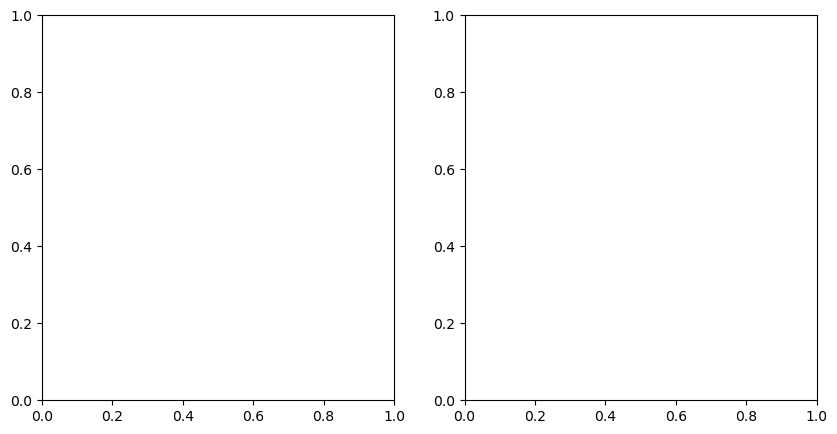

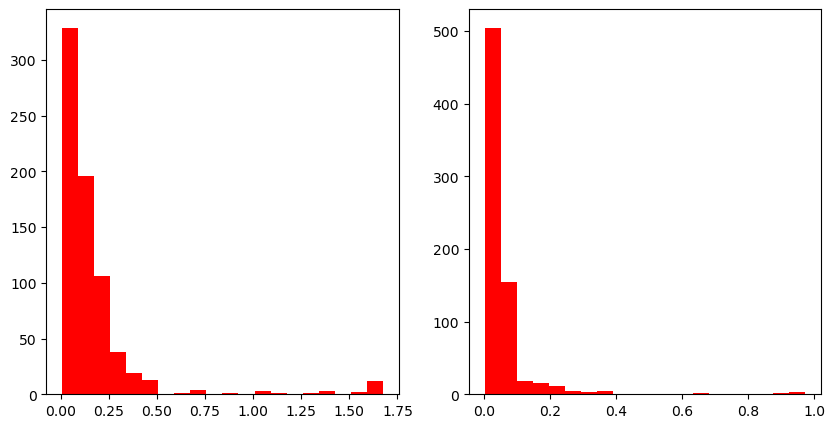

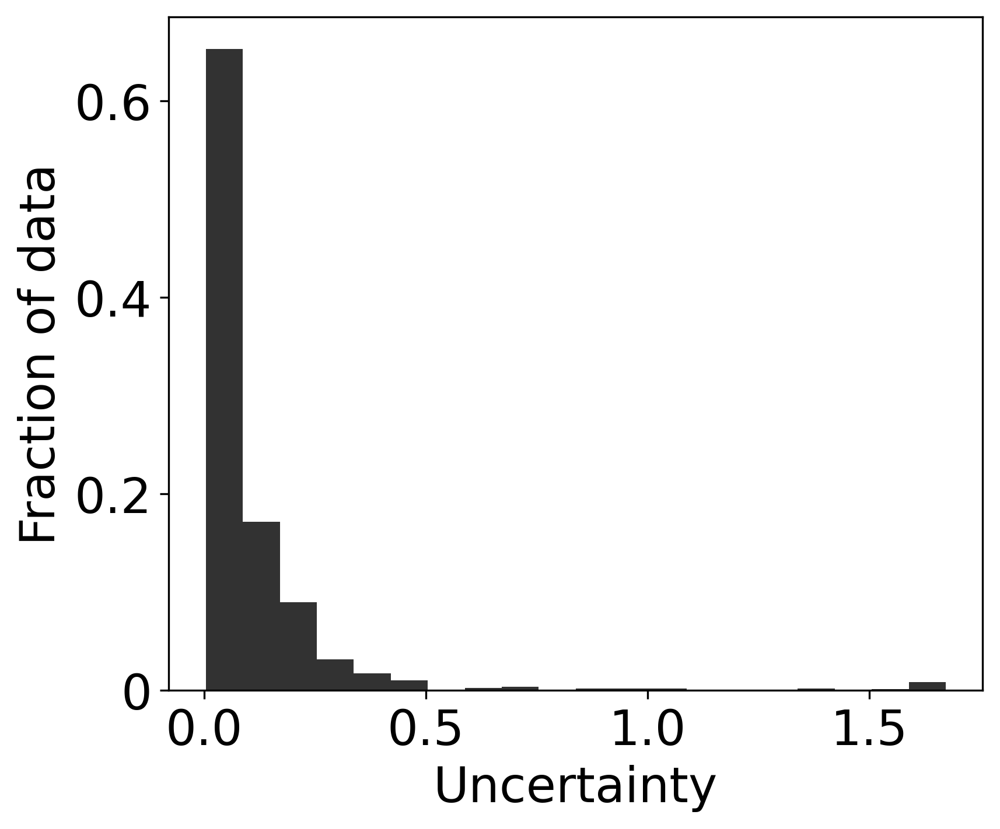

In [ ]:
# plot predpred_full['nestd/mean'] pred_full['testd/mean'] as a fn of R
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
#axs[0].scatter(pred_full['R_0'], pred_full['nestd/mean'], color='r',
#               marker='D', s=size)
#axs[1].scatter(pred_full['R_0'], pred_full['testd/mean'], color='r',
#                marker='D', s=size)
#plot historgam of nestd/mean and testd/mean
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].hist(pred_full['nestd/mean'], bins=20, color='r')
axs[1].hist(pred_full['testd/mean'], bins=20, color='r')

# plot nestd/mean and testd/mean in one histogram
fig, axs = plt.subplots(1, 1, figsize=(6, 5), dpi = 300)
unsertainty = pd.concat([pred_full['nestd/mean'], pred_full['testd/mean']], axis=0)
#err = pd.concat([pred_full['ne_err'], pred_full['Te_err']], axis=0)
axs.hist(unsertainty, bins=20, color='#323232')
axs.set_xlabel('Uncertainty', fontsize=20)
axs.set_ylabel('Fraction of data', fontsize=20)
# replace y axis with % of data
# replace 200, 400, 800 on y axis with 200/len(uncertainty)*100, 400/len(uncertainty)*100, 800/len(uncertainty)*100
ticks = [0, len(unsertainty)*0.2, len(unsertainty)*0.4, len(unsertainty)*0.6]
tick_labels = ['0', '0.2', '0.4', '0.6']
plt.yticks(ticks, tick_labels, fontsize=20)
plt.xticks(fontsize=20)
# have x ticks every 0.5
plt.xticks(np.arange(0, 2, 0.5))



In [ ]:
# get the shot and R_0 of data with largest error
pred_order = pred_full.sort_values(by=['ne_per_err'], ascending=True
                                   )
# print(pred_order rows 10-15
print(pred_order.iloc[0:10, :])

KeyError: 'ne_per_err'

shot: 13103 ne_err: nan Te_err: nan
shot: 13103 ne_con: nan Te_con: nan


IndexError: index 0 is out of bounds for axis 0 with size 0

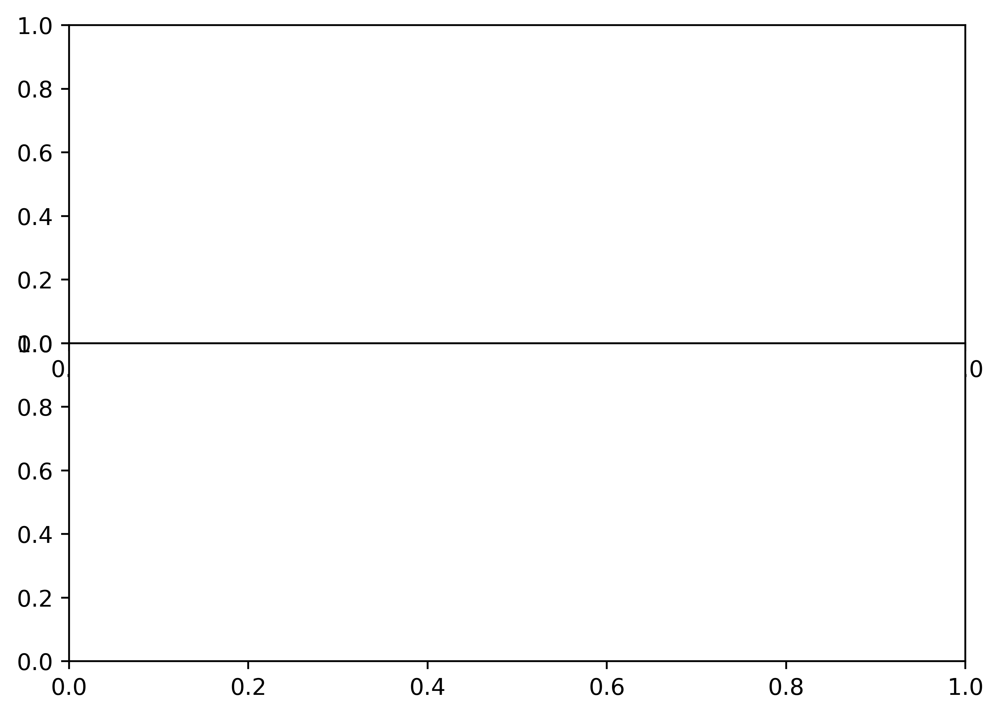

In [ ]:
# plot ne vs r0

# append shot number to IV_Test_y and pred_full from all_data_test
# reset index 
#IV_Test_y = IV_Test_y.reset_index(drop=True)
#pred_full = pred_full.reset_index(drop=True)
#all_data_test = all_data_test.reset_index(drop=True)
IV_Test_y['shot'] = all_data_test['shot']
pred_full['shot'] = all_data_test['shot']
IV_Test_X['shot'] = all_data_test['shot']

alphapred = 0.7
sizepred = 20
single = ['13103']
single = np.array(single)
for shot in single:
    fig, axs = plt.subplots(2, 1, figsize=(7, 5), dpi =500)
    # get av error for whole shot in ne and Te
    ne_err = pred_full[pred_full['shot'] == shot]['ne_per_err']
    Te_err = pred_full[pred_full['shot'] == shot]['Te_per_err']
   
    ne_err = np.mean(ne_err)
    Te_err = np.mean(Te_err)
    
    # print shot with errors to 2sf
    print('shot: ' + str(int(shot)) + ' ne_err: ' + str(round(ne_err, 2)) + ' Te_err: ' + str(round(Te_err, 2)))
    #do the same for std
    ne_std = pred_full[pred_full['shot'] == shot]['ne_std']
    te_std = pred_full[pred_full['shot'] == shot]['Te_std']
    ne_val = pred_full[pred_full['shot'] == shot]['ne_mean']
    te_val = pred_full[pred_full['shot'] == shot]['Te_mean']

    ne_con = ne_std/ne_val
    te_con = te_std/te_val
    ne_con = np.mean(ne_con)
    te_con = np.mean(te_con)
    print('shot: ' + str(int(shot)) + ' ne_con: ' + str(round(ne_con, 2)) + ' Te_con: ' + str(round(te_con, 2)))

    
    #plt.subplots_adjust(top=1.5, bottom=0.01)
    plt.subplots_adjust(hspace=0)
    alpha = 0.2
    fs =10
    size = 50
    # get data for shot in all_data_test
    data_pos = all_data_test[all_data_test['shot'] == shot]
    # get R at data_pos
    R = data_pos['R_0']
    IV_Test_y_pos = IV_Test_y[IV_Test_y['shot'] == shot]
    pred_full_pos = pred_full[pred_full['shot'] == shot]
    gas_name = data_pos['gas_name'].unique()
    # make gas name just the letters
    gas_name = gas_name[0][0:2]
    # plot r0 vs ne
    axs[0].set_title( '  [#' + str(int(shot)) + ', Gas: '+ str(gas_name) + ']', 
                        fontsize=fs, loc='Right')
    
    #axs[0].fill_between(R, (IV_Test_y_pos['ne']*(1-0.1)), 
    #                   (IV_Test_y_pos['ne']*(1+0.1)), alpha=alpha, 
    #                   label='10% error', color='#323232')
#
    #axs[0].scatter(R, IV_Test_y_pos['ne'], label='Ground Truth *sqrt(20)', s=size, color = '#FF0000', marker = 'o')
    axs[1].errorbar(R, pred_full_pos['Te_mean'], yerr=pred_full_pos['Te_std'], fmt='none', ecolor='#00BEFF',alpha=alphapred,capsize=5)
    axs[0].errorbar(R, pred_full_pos['ne_mean'], yerr=pred_full_pos['ne_std'], fmt='none', ecolor='#00BEFF',alpha=alphapred,capsize=5)

    # add 10% area error around true value
    #axs[0].get_ylabel('$n_e$')
    # make y log scale
    #axs[0].set_yscale('log')
    # add legend
    
    axs[0].yaxis.get_offset_text().set_fontsize(fs +5)
    # add y label
    axs[0].set_ylabel('$n_e$ [m$^{-3}$]', fontsize=fs+10)
    # remove ticks for x axis on [0]
    axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

    # plot r0 vs Te
    axs[1].fill_between(R, IV_Test_y_pos['Te']*(1-0.1), IV_Test_y_pos['Te']*(1+0.1), alpha=alpha, label='10% error',
                        color='#323232')

    axs[1].scatter(R, IV_Test_y_pos['Te'], label='Ground Truth',  s=size, color = '#323232', marker = 'H')
    axs[1].scatter(R, pred_full_pos['Te_mean'], label='Predicted', color= "#00BEFF", marker='D', s=sizepred, 
                     alpha=alphapred) #edgecolors = 'white',
    # add error bar to predicted values

    # add 10% area error around true value
    axs[0].grid(True, alpha=0.3)
    axs[1].grid(True, alpha=0.3)
    # make y log scale
    #axs[0].set_yscale('log')
    # set max on y axis as 9.9 
    #axs[1].set_ylim(3, 9)
    # add legend
    #axs[1].legend(loc='upper left', fontsize=fs-2)
    # add y label
    axs[1].set_ylabel('$T_e$ [eV]', fontsize=fs+10)
    # add x label
    axs[1].set_xlabel('$R-R_0$ [m]', fontsize=fs+5)
    # xticks size
    axs[1].tick_params(axis='both', which='major', labelsize=fs+3)
    # yticks size
    axs[0].tick_params(axis='both', which='major', labelsize=fs+3)
    # plot figure
    #print('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_ne.dat')
    #if os.path.exists('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_ne.dat') == True:
#
    #    refitne = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_ne.dat'
    #                        , sep='\t')
    #    refitTe = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\refit\\shot' + str(int(shot)) + '\\auswert\\shot' + str(int(shot)) + 'refit_Te.dat',
    #                        sep='\t')
    #    #name columns
    #    #print(refitne)
    #    refitne.columns = ['R_0', 'ne']
    #    refitTe.columns = ['R_0', 'Te']
    #    axs[0].fill_between(refitne['R_0'], (refitne['ne']*(1-0.1)),
    #                        (refitne['ne']*(1+0.1)), alpha=alpha, label='10% error',
    #                          color='#323232')
    #    axs[0].scatter(refitne['R_0'], refitne['ne'], label='Refit',
    #                    color='r', marker='^', s=size+10,
    #    edgecolors='white')
    #    #axs[1].scatter(refitTe['R_0'], refitTe['Te'], label='Refit', color='#00FF00', marker='D', s=size-30,
        #edgecolors='white')
        # add error bars by filling area between 10% error

        
    axs[0].scatter(R,IV_Test_y_pos['ne'], label='Ground Truth', s=size, color = '#323232', marker = 'H')
    axs[0].scatter(R,(pred_full_pos['ne_mean']), label='Predicted', color= "#00BEFF", marker='D', s=sizepred, 
                     alpha=alphapred) #edgecolors='white',
    #axs[0].scatter(R,(IV_Test_y_pos['ne']*np.sqrt(20)), label='Predicted', color= "red", marker='D', s=sizepred, 
    #alpha=alphapred) #edgecolors='white',
    axs[0].fill_between(R, IV_Test_y_pos['ne']*(1-0.1), IV_Test_y_pos['ne']*(1+0.1), alpha=alpha, label='10% error',
                        color='#323232')
# make axs 0 y log
    #axs[0].set_yscale('log')

    axs[1].legend().set_visible(False)
    axs[0].legend(loc='upper right', fontsize=fs)



## Stats surrounding fullshot prediction

In [ ]:
# find the average error of ne and te groued by R
# add r column to pred_full_pos
pred_full['R_0'] = all_data_test['R_0']
# same for gas
pred_full['gas'] = all_data_test['gas']

C:\Users\jasmi\AppData\Local\Temp\ipykernel_4220\2004748596.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pred_full_grouped = pred_full.groupby('R_0').mean()


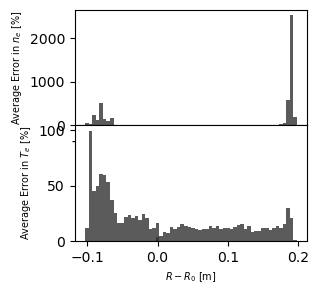

In [ ]:
# group by R_0 and find mean
pred_full_grouped = pred_full.groupby('R_0').mean()
pred_full_grouped['R_0'] = pred_full_grouped.index
fs =2
# plot bar chart of R_0 on x and mean error on y 2 subplots one for te one for ne
# plot ne
barWidth = 0.005
fig, axs = plt.subplots(2, 1, figsize=(3, 3))#, dpi=500)
axs[0].bar(pred_full_grouped['R_0'], pred_full_grouped['ne_per_err'], 
           color='#323232', alpha=0.8, width = barWidth)
# plot te,
axs[1].bar(pred_full_grouped['R_0'], pred_full_grouped['Te_per_err'], 
           color='#323232', alpha=0.8,width = barWidth)
# y labe set to average error in Ne and Te
axs[0].set_ylabel('Average Error in $n_e$ [%]', fontsize=fs+5)
axs[1].set_ylabel('Average Error in $T_e$ [%]', fontsize=fs+5)
# x label set to R_0
axs [1].set_xlabel('$R-R_0$ [m]', fontsize=fs+5)

# set y lim to 0-100
#axs[0].set_ylim(0, 400)
#axs[1].set_ylim(0, 100)
plt.subplots_adjust(hspace=0)
# save pred_full_grouped as csv
#pred_full_grouped.to_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\pred_full_grouped_42_2.csv', sep='\t')

2517.9848950458686 99.48911593767617


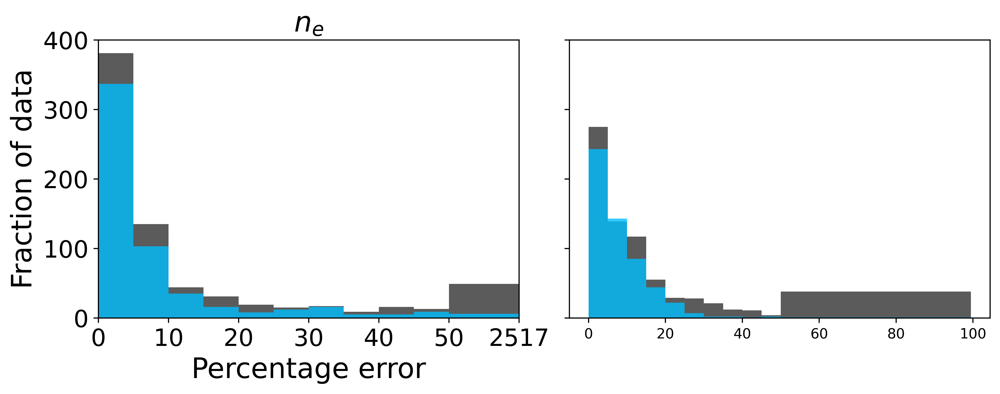

In [ ]:


not_cleaned = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\pred_full1.csv', sep='\t', header=0)
cleaned = pd.read_csv('C:\\Users\\jasmi\\Documents\\FUSION_EP\\Master_Thesis\\Data\\pred_full_cleaned.csv', sep='\t', header=0)
# Remove all rows with percentage error > 50%
# cleaned = cleaned[cleaned['Te_per_err'] < 50]
# not_cleaned = not_cleaned[not_cleaned['Te_per_err'] < 50]
not_cleaned = pred_full
alpha = 0.8
boolnorm = False
# cleaned #00BEFF
# not_cleaned #323232
# Get the largest error in ne and Te
max_ne = max(not_cleaned['ne_per_err'])
max_te = max(not_cleaned['Te_per_err'])
print(max_ne, max_te)
# 
fs = 20

fig, ax = plt.subplots(1, 2, figsize=(10, 4), dpi=500, sharey=True)
plt.subplots_adjust(wspace=0)

bin_intervals_ne = [0,5, 10,15,20,25,30,35,40,45,50, max_ne]
bin_intervals_te = [0,5, 10,15,20,25,30,35,40,45,50, max_te]



ne_counts, ne_bins, ne_patches = ax[0].hist(not_cleaned['ne_per_err'],color = '#323232', density=boolnorm, alpha=alpha, bins=bin_intervals_ne)
ne_counts, ne_bins, ne_patches = ax[0].hist(cleaned['ne_per_err'],color ='#00BEFF', density=boolnorm, alpha=alpha, bins=bin_intervals_ne)
#ne_counts, ne_bins, ne_patches = ax[0].hist(cleaned['ne_per_err'],color = '#00BEFF', density=boolnorm, alpha=alpha, bins=bin_intervals_ne)

ax[0].set_xlabel('Percentage error', fontsize=fs)
ax[0].set_ylabel('Fraction of data', fontsize=fs)
ax[0].set_title('$n_e$', fontsize=fs)
ax[0].tick_params(axis='both', labelsize=fs-3)
ax[0].set_xticks([0, 10, 20, 30,40, 50,60], ['0', '10', '20', '30', '40', '50', str(int(max_ne))])
#ax[0].set_yticks([61.8, 123.6,185.4,247.2,309])
#ax[0].set_yticklabels(['0.1',f"{100/len(cleaned):.1g}",f"{150/len(cleaned):.1g}", f"{200/len(cleaned):.1g}",f"{250/len(cleaned):.1g}", f"{300/len(cleaned):.1g}"])
#ax[0].set_yticklabels([f"{100/len(cleaned):.1g}", f"{200/len(cleaned):.1g}",f"{300/len(cleaned):.1g}"])
#ax[0].set_yticklabels(['0.1','0.2','0.3', '0.4' ,'0.5'])
ax[0].set_xlim(0, 60)

te_counts, te_bins, te_patches = ax[1].hist(not_cleaned['Te_per_err'],color = '#323232', density=boolnorm, alpha=alpha, bins=bin_intervals_te)
te_counts, te_bins, te_patches = ax[1].hist(cleaned['Te_per_err'],color ='#00BEFF', density=boolnorm, alpha=alpha, bins=bin_intervals_te)



plt.tight_layout()
plt.show()

# get the windows and counts from the historgram




             index  Te_per_err
0       [0.0, 5.0)         243
1      [5.0, 10.0)         143
2     [10.0, 15.0)          85
3     [15.0, 20.0)          44
4     [20.0, 25.0)          22
5     [25.0, 30.0)           7
6     [30.0, 35.0)           2
7     [35.0, 40.0)           2
8     [45.0, 50.0)           2
9     [40.0, 45.0)           1
10  [50.0, 99.489)           1


TypeError: float() argument must be a string or a real number, not 'pandas._libs.interval.Interval'

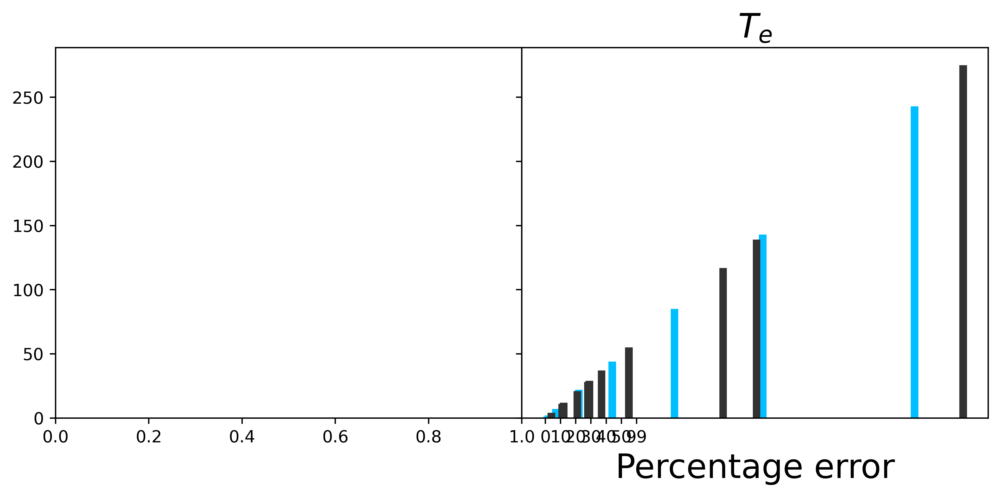

In [ ]:


# Assuming 'df' is your DataFrame

bin_intervals_ne = [0,5, 10,15,20,25,30,35,40,45,50, max_ne]
bin_intervals_te = [0,5, 10,15,20,25,30,35,40,45,50, max_te]
histogram_dataTE = pd.cut(cleaned['Te_per_err'], bins=bin_intervals_te, include_lowest=True, right=False).value_counts().reset_index()
print(histogram_dataTE)
histogram_dataTE.columns = ['bin_range', 'count']
historgramNE_data = pd.cut(cleaned['ne_per_err'], bins=bin_intervals_ne, include_lowest=True, right=False).value_counts().reset_index()
historgramNE_data.columns = ['bin_range', 'count']
histogram_dataTE_nc = pd.cut(not_cleaned['Te_per_err'], bins=bin_intervals_te, include_lowest=True, right=False).value_counts().reset_index()
histogram_dataTE_nc.columns = ['bin_range', 'count']
historgramNE_data_nc = pd.cut(not_cleaned['ne_per_err'], bins=bin_intervals_ne, include_lowest=True, right=False).value_counts().reset_index()
historgramNE_data_nc.columns = ['bin_range', 'count']

fig, ax = plt.subplots(1, 2, figsize=(10, 4), dpi=500, sharey=True)
plt.subplots_adjust(wspace=0)
ax[1].bar(histogram_dataTE['count'], histogram_dataTE['count'], width=5, color='#00BEFF')
ax[1].bar(histogram_dataTE_nc['count'], histogram_dataTE_nc['count'], width=5, color='#323232')
ax[1].set_xlabel('Percentage error', fontsize=fs)
ax[1].set_title('$T_e$', fontsize=fs)
ax[1].set_xticks([0, 10, 20, 30,40, 50,60], ['0', '10', '20', '30', '40', '50', str(int(max_te))])

ax[0].bar(historgramNE_data['bin_range'], historgramNE_data['count'], width=5, color='#00BEFF')
ax[0].bar(historgramNE_data_nc['bin_range'], historgramNE_data_nc['count'], width=5, color='#323232')





In [ ]:
'''
fig, axs = plt.subplots(2, 1, figsize=(7, 5), dpi =500)


#plt.subplots_adjust(top=1.5, bottom=0.01)
plt.subplots_adjust(hspace=0)
alpha = 0.2
fs =10
size = 20

axs[0].scatter(all_data_test['R_0'],(pred_full['ne_per_err']), label='error', s=size,
                color = '#323232', marker = 'o',alpha=0.8)



axs[0].set_ylabel('% error on $n_e$', fontsize=fs+5)
axs[1].set_ylabel('% error on $T_e$', fontsize=fs+5)

axs[1].scatter(all_data_test['R_0'], pred_full['Te_per_err'], label='error', 
                color= "#323232", 
                marker='o', s=size, 
                edgecolors = 'white', alpha=0.8)
# add 10% area error around true value
axs[0].grid(True, alpha=0.3)
axs[1].grid(True, alpha=0.3)

# add x label
axs[1].set_xlabel('$R-R_0$ [m]', fontsize=fs+5)


x_lim = 150
axs[0].set_ylim(-10, x_lim+5)
#if any in pred_full_pos['ne_pre'] <= 0: plot as a red cross
for i in range(0, len(pred_full)):
    if pred_full['ne_per_err'].iloc[i] >= x_lim:
        axs[0].scatter(all_data_test['R_0'].iloc[i], x_lim, color='red', 
                       marker='x', s=size, label = 'error >' +str(x_lim) + '%')
    ###
    # 
#axs[0].legend(loc='upper left', fontsize=fs)
# change legend so that it only shows one entry for the error
handles, labels = axs[0].get_legend_handles_labels()
# Filter handles and labels to keep only the error and one >400% point
filtered_handles = [handles[0], handles[1]]  # Adjust the indices based on your plot
filtered_labels = [labels[0], labels[1]]  # Adjust the indices based on your plot

# Create the legend with the filtered handles and labels
axs[1].legend(filtered_handles, filtered_labels, loc='upper left', fontsize=fs)

#remove lenegd form first
axs[0].legend().set_visible(False)
#p ut y ticks evert 25
axs[0].set_yticks(np.arange(0, x_lim+1, 25), fontsize=fs)
axs[1].set_yticks(np.arange(0, x_lim-5, 25), fontsize=fs)
'''


'\nfig, axs = plt.subplots(2, 1, figsize=(7, 5), dpi =500)\n\n\n#plt.subplots_adjust(top=1.5, bottom=0.01)\nplt.subplots_adjust(hspace=0)\nalpha = 0.2\nfs =10\nsize = 20\n\naxs[0].scatter(all_data_test[\'R_0\'],(pred_full[\'ne_per_err\']), label=\'error\', s=size,\n                color = \'#323232\', marker = \'o\',alpha=0.8)\n\n\n\naxs[0].set_ylabel(\'% error on $n_e$\', fontsize=fs+5)\naxs[1].set_ylabel(\'% error on $T_e$\', fontsize=fs+5)\n\naxs[1].scatter(all_data_test[\'R_0\'], pred_full[\'Te_per_err\'], label=\'error\', \n                color= "#323232", \n                marker=\'o\', s=size, \n                edgecolors = \'white\', alpha=0.8)\n# add 10% area error around true value\naxs[0].grid(True, alpha=0.3)\naxs[1].grid(True, alpha=0.3)\n\n# add x label\naxs[1].set_xlabel(\'$R-R_0$ [m]\', fontsize=fs+5)\n\n\nx_lim = 150\naxs[0].set_ylim(-10, x_lim+5)\n#if any in pred_full_pos[\'ne_pre\'] <= 0: plot as a red cross\nfor i in range(0, len(pred_full)):\n    if pred_full[\'ne